# **Subject: Advance mathematical Applications for Deep Learning II**

# Project_I: Human Emotion **Detection**

Team Members: Virajkumar Tank (101411542)

Problem Statement: I will try to fine-tune a model by changing its parameters, implementing pre-trained model in order to achive higher accuracy and also I will prepare it for emotion detection in video.

Dataset Description: I am going to develop a deep learning neural network model which will detect Emotions of Humans. The dataset contain 35,685 examples of 48x48 pixel gray scale images of faces divided into train and test dataset. The training set includes 28,709 images, the testing set includes 7178 images. Images are categorized based on the emotion shown in the facial expressions (happiness, neutral, sadness, anger, surprise, disgust, fear).

The existing notebook I have used to classify level of water bottle has accuracy of around 60-65% and Convolutional Neural Network(CNN) is being used but accuracy of the model is not upto mark.

Kaggle Dataset Link: https://www.kaggle.com/datasets/ananthu017/emotion-detection-fer/code?resource=download

Existing notebook link: https://www.kaggle.com/code/aryan348/emotion-detection-cnn

I tried to increase the accuracy by fine tunning of CNN model and also tried to capture emotions from a video.

# Importing Libraries

In [1]:
import os
import random
import zipfile
from PIL import Image
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import matplotlib.pyplot as plt
import seaborn as sns
import tensorflow as tf
import keras
from keras.preprocessing import image
from keras.models import Sequential
from keras.layers import Conv2D, MaxPool2D, Flatten,Dense,Dropout,BatchNormalization
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.models import load_model
from tensorflow.python.keras import regularizers
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from keras.preprocessing import image

## Unzip Downloaded file

In [2]:
# Unzip the downloaded file
zip_ref = zipfile.ZipFile("archive.zip", "r")
zip_ref.extractall()
zip_ref.close()

## Dataset Preparation

In [3]:
dataset_path = "/content/archive"

labels = os.listdir(dataset_path)
print(labels)

for label in labels:
    print(os.listdir(os.path.join(dataset_path, label)))    #listing number of folders and sub-folders in dataset

[]


In [4]:
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

In [5]:
train_dir = "/content/archive/train"
test_dir = "../content/archive/test"

## Preparing Data using data generator for training data

In [7]:
#preparing training data
img_size=48
train_datagen = ImageDataGenerator(      width_shift_range = 0.1,
                                         height_shift_range = 0.1,
                                         horizontal_flip = True,
                                         rescale = 1./255,
                                         validation_split = 0.2
                                        )

train_generator = train_datagen.flow_from_directory(directory = train_dir,
                                                    target_size = (img_size,img_size),
                                                    batch_size = 64,
                                                    color_mode = "grayscale",
                                                    class_mode = "categorical",
                                                    subset = "training"
                                                   )

Found 22968 images belonging to 7 classes.


## Preparing Data using data generator for training data

In [8]:
#preparing validation dataset
validation_datagen = ImageDataGenerator(rescale = 1./255,
                                         validation_split = 0.2)

validation_generator = validation_datagen.flow_from_directory( directory = test_dir,
                                                              target_size = (img_size,img_size),
                                                              batch_size = 64,
                                                              color_mode = "grayscale",
                                                              class_mode = "categorical",
                                                              subset = "validation"
                                                             )

Found 1432 images belonging to 7 classes.


## plotting an image

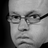

In [9]:
img = Image.open('/content/archive/test/angry/im106.png')
img.show()

image in grayscale

(48, 48)


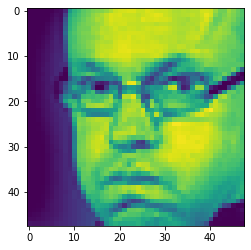

In [10]:
img = load_img('/content/archive/test/angry/im106.png', target_size=(48, 48), color_mode = "grayscale")
img = np.array(img)
plt.imshow(img)
print(img.shape)

## plotting random image from training dataset

In [11]:
train_ds = tf.keras.preprocessing.image_dataset_from_directory(
  directory='/content/archive',
  validation_split=0.2,
  subset="training",
  seed=123,
  image_size=(224, 224),
  batch_size=32)

Found 35887 files belonging to 2 classes.
Using 28710 files for training.


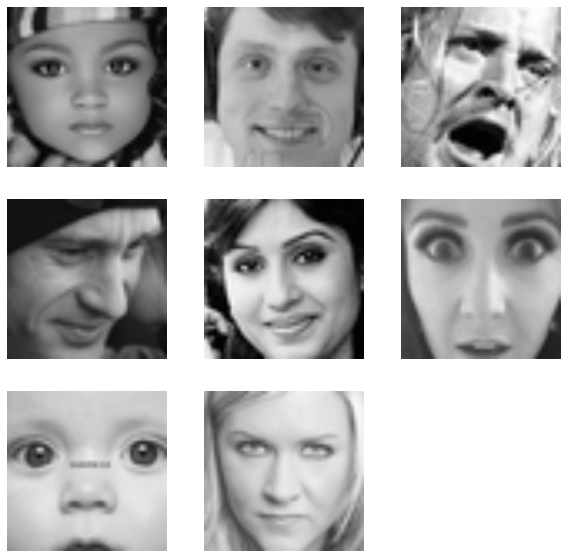

In [12]:
# Get a random sample from the training dataset
random_sample = train_ds.take(1)

# Display the images in the random sample
import matplotlib.pyplot as plt
plt.figure(figsize=(10, 10))
for images, labels in random_sample:
    for i in range(8):
        ax = plt.subplot(3, 3, i + 1)
        plt.imshow(images[i].numpy().astype("uint8"))
        plt.axis("off")

## Creating and Compling the Model

In [13]:
from tensorflow.keras.optimizers import Adam,RMSprop,SGD,Adamax
model1= tf.keras.models.Sequential()
model1.add(Conv2D(32, kernel_size=(3, 3), padding='same', activation='relu', input_shape=(48, 48,1)))
model1.add(Conv2D(64,(3,3), padding='same', activation='relu' ))
model1.add(BatchNormalization())
model1.add(MaxPool2D(pool_size=(2, 2)))
model1.add(Dropout(0.25))

model1.add(Conv2D(128,(5,5), padding='same', activation='relu'))
model1.add(BatchNormalization())
model1.add(MaxPool2D(pool_size=(2, 2)))
model1.add(Dropout(0.25))
    
model1.add(Conv2D(512,(3,3), padding='same', activation='relu', kernel_regularizer=regularizers.l2(0.01)))
model1.add(BatchNormalization())
model1.add(MaxPool2D(pool_size=(2, 2)))
model1.add(Dropout(0.25))

model1.add(Flatten()) 
model1.add(Dense(256,activation = 'relu'))
model1.add(BatchNormalization())
model1.add(Dropout(0.25))
    
model1.add(Dense(512,activation = 'relu'))
model1.add(BatchNormalization())
model1.add(Dropout(0.25))

model1.add(Dense(7, activation='softmax'))

model1.compile(
    optimizer = Adam(lr=0.0001), 
    loss='categorical_crossentropy', 
    metrics=['accuracy']
  )

In [14]:
model1.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 48, 48, 32)        320       
                                                                 
 conv2d_1 (Conv2D)           (None, 48, 48, 64)        18496     
                                                                 
 batch_normalization (BatchN  (None, 48, 48, 64)       256       
 ormalization)                                                   
                                                                 
 max_pooling2d (MaxPooling2D  (None, 24, 24, 64)       0         
 )                                                               
                                                                 
 dropout (Dropout)           (None, 24, 24, 64)        0         
                                                                 
 conv2d_2 (Conv2D)           (None, 24, 24, 128)       2

## Fit the Model

In [15]:
epochs= 50
batch_size=60
history = model1.fit(x = train_generator,epochs = epochs,validation_data = validation_generator)

Epoch 1/50
359/359 [==============================] - 45s 84ms/step - loss: 3.0613 - accuracy: 0.2375 - val_loss: 2.7137 - val_accuracy: 0.1425
Epoch 2/50
359/359 [==============================] - 27s 74ms/step - loss: 1.9217 - accuracy: 0.3173 - val_loss: 1.9814 - val_accuracy: 0.3003
Epoch 3/50
359/359 [==============================] - 28s 77ms/step - loss: 1.8640 - accuracy: 0.3929 - val_loss: 2.3227 - val_accuracy: 0.3073
Epoch 4/50
359/359 [==============================] - 27s 74ms/step - loss: 1.7673 - accuracy: 0.4407 - val_loss: 1.7744 - val_accuracy: 0.4595
Epoch 5/50
359/359 [==============================] - 27s 75ms/step - loss: 1.7228 - accuracy: 0.4742 - val_loss: 1.5790 - val_accuracy: 0.5126
Epoch 6/50
359/359 [==============================] - 27s 74ms/step - loss: 1.6823 - accuracy: 0.4899 - val_loss: 1.6165 - val_accuracy: 0.5126
Epoch 7/50
359/359 [==============================] - 27s 76ms/step - loss: 1.6302 - accuracy: 0.5133 - val_loss: 1.7272 - val_accuracy:

In [16]:
# get the list of all file paths in train_ds
file_paths = train_ds.file_paths

# randomly select 10 file paths
random_files = random.sample(file_paths, 10)

# load the images corresponding to the random file paths
images = []
for file_path in random_files:
    img = tf.keras.preprocessing.image.load_img(file_path, target_size=(224, 224))
    img_array = tf.keras.preprocessing.image.img_to_array(img)
    images.append(img_array)

## Evaluating Model by Plotting Loss Curve

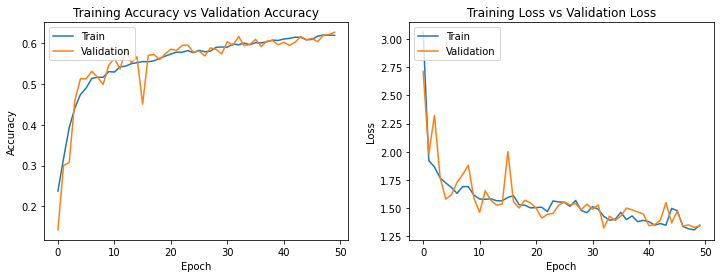

In [17]:
fig , ax = plt.subplots(1,2)
train_acc = history.history['accuracy']
train_loss = history.history['loss']
fig.set_size_inches(12,4)

ax[0].plot(history.history['accuracy'])
ax[0].plot(history.history['val_accuracy'])
ax[0].set_title('Training Accuracy vs Validation Accuracy')
ax[0].set_ylabel('Accuracy')
ax[0].set_xlabel('Epoch')
ax[0].legend(['Train', 'Validation'], loc='upper left')

ax[1].plot(history.history['loss'])
ax[1].plot(history.history['val_loss'])
ax[1].set_title('Training Loss vs Validation Loss')
ax[1].set_ylabel('Loss')
ax[1].set_xlabel('Epoch')
ax[1].legend(['Train', 'Validation'], loc='upper left')

plt.show()

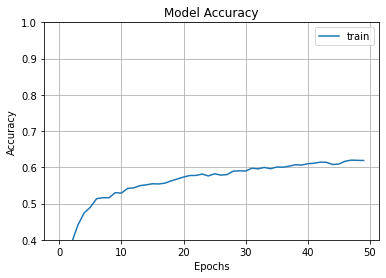

In [18]:
fig1 = plt.gcf()
plt.plot(history.history['accuracy'])
plt.axis(ymin=0.4,ymax=1)
plt.grid()
plt.title('Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epochs')
plt.legend(['train'])
plt.show()

## save model to use as pre-trained model

In [23]:
model1.save('model_1.h5')
model1.save_weights('model_weights.h5')

In [25]:
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.layers import Conv2D, MaxPool2D, Dropout, BatchNormalization, Flatten, Dense
from tensorflow.keras import regularizers
from tensorflow.keras.preprocessing.image import ImageDataGenerator

## Origial Content

## Model 2

### here we have changed learning rate, number of epochs, batch size and number of filters

In [26]:
model_2 = tf.keras.models.Sequential([
Conv2D(32, kernel_size=(3, 3), padding='same', activation='relu', input_shape=(48, 48, 1)),
Conv2D(64, (3,3), padding='same', activation='relu'),
BatchNormalization(),
MaxPool2D(pool_size=(2, 2)),
Dropout(0.3),

Conv2D(128, (5,5), padding='same', activation='relu'),
BatchNormalization(),
MaxPool2D(pool_size=(2, 2)),
Dropout(0.4),

Conv2D(256, (3,3), padding='same', activation='relu', kernel_regularizer=regularizers.l2(0.01)),
BatchNormalization(),
MaxPool2D(pool_size=(2, 2)),
Dropout(0.5),

Flatten(),
Dense(256, activation='relu'),
BatchNormalization(),
Dropout(0.5),

Dense(128, activation='relu'),
BatchNormalization(),
Dropout(0.5),

Dense(7, activation='softmax')
])

In [27]:
optimizer = Adam(lr=0.001)
model_2.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics=['accuracy'])

In [28]:
train_datagen = ImageDataGenerator(
rescale=1./255,
rotation_range=10,
zoom_range=0.1,
horizontal_flip=True
)

validation_datagen = ImageDataGenerator(
rescale=1./255
)

In [31]:
train_generator = train_datagen.flow_from_directory(
'/content/archive/train',
target_size=(48, 48),
batch_size=64,
color_mode='grayscale',
class_mode='categorical'
)

validation_generator = validation_datagen.flow_from_directory(
'/content/archive/test',
target_size=(48, 48),
batch_size=64,
color_mode='grayscale',
class_mode='categorical'
)

history_2 = model_2.fit(
train_generator,
steps_per_epoch=train_generator.samples/train_generator.batch_size,
epochs=5,
validation_data=validation_generator,
validation_steps=validation_generator.samples/validation_generator.batch_size,
verbose=1
)

Found 28709 images belonging to 7 classes.
Found 7178 images belonging to 7 classes.
Epoch 1/5
448/448 [==============================] - 37s 83ms/step - loss: 2.2919 - accuracy: 0.2979 - val_loss: 2.3117 - val_accuracy: 0.3217
Epoch 2/5
448/448 [==============================] - 37s 82ms/step - loss: 1.7883 - accuracy: 0.3959 - val_loss: 1.7279 - val_accuracy: 0.4071
Epoch 3/5
448/448 [==============================] - 35s 79ms/step - loss: 1.7023 - accuracy: 0.4387 - val_loss: 1.7077 - val_accuracy: 0.4280
Epoch 4/5
448/448 [==============================] - 36s 80ms/step - loss: 1.6777 - accuracy: 0.4614 - val_loss: 1.6121 - val_accuracy: 0.4882
Epoch 5/5
448/448 [==============================] - 36s 79ms/step - loss: 1.6506 - accuracy: 0.4749 - val_loss: 1.5657 - val_accuracy: 0.5104


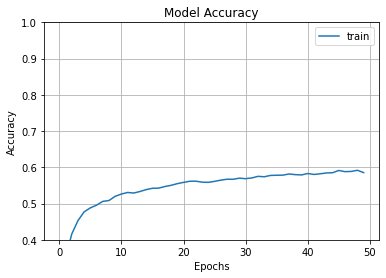

In [ ]:
fig1 = plt.gcf()
plt.plot(history_2.history['accuracy'])
plt.axis(ymin=0.4,ymax=1)
plt.grid()
plt.title('Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epochs')
plt.legend(['train'])
plt.show()

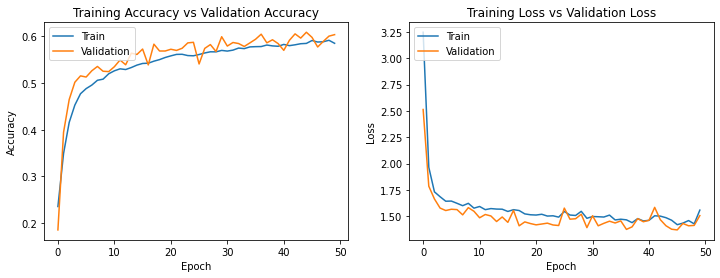

In [ ]:
fig , ax = plt.subplots(1,2)
train_acc = history_2.history['accuracy']
train_loss = history_2.history['loss']
fig.set_size_inches(12,4)

ax[0].plot(history_2.history['accuracy'])
ax[0].plot(history_2.history['val_accuracy'])
ax[0].set_title('Training Accuracy vs Validation Accuracy')
ax[0].set_ylabel('Accuracy')
ax[0].set_xlabel('Epoch')
ax[0].legend(['Train', 'Validation'], loc='upper left')

ax[1].plot(history_2.history['loss'])
ax[1].plot(history_2.history['val_loss'])
ax[1].set_title('Training Loss vs Validation Loss')
ax[1].set_ylabel('Loss')
ax[1].set_xlabel('Epoch')
ax[1].legend(['Train', 'Validation'], loc='upper left')

plt.show()

It is clear from the Accuracy and Loss Curve that I am not getting accuracy I am looking for.

In [ ]:

# Evaluate the model on the test data
test_loss, test_acc = model_2.evaluate(train_generator)
print('Test accuracy:', test_acc)


449/449 [==============================] - 22s 48ms/step - loss: 1.4520 - accuracy: 0.6213
Test accuracy: 0.6212685704231262


In [ ]:
# Evaluate the model on the test data
test_loss, test_acc = model_2.evaluate(validation_generator)
print('Test accuracy:', test_acc)

113/113 [==============================] - 3s 29ms/step - loss: 1.5065 - accuracy: 0.6039
Test accuracy: 0.6039286851882935


## Here I have applied model with more complex layes and I have changed the activation function to Swish in some of layers

In [ ]:
model_3 = tf.keras.models.Sequential([
Conv2D(32, kernel_size=(3, 3), padding='same', activation='swish', input_shape=(48, 48, 1)),
Conv2D(64, (3,3), padding='same', activation='relu'),
BatchNormalization(),
MaxPool2D(pool_size=(2, 2)),
Dropout(0.3),

Conv2D(128, (5,5), padding='same', activation='swish'),
BatchNormalization(),
MaxPool2D(pool_size=(2, 2)),
Dropout(0.4),

Conv2D(512, (3,3), padding='same', activation='swish', kernel_regularizer=regularizers.l2(0.01)),
BatchNormalization(),
MaxPool2D(pool_size=(2, 2)),
Dropout(0.5),

Flatten(),
Dense(256, activation='swish'),
BatchNormalization(),
Dropout(0.5),

Dense(128, activation='swish'),
BatchNormalization(),
Dropout(0.5),

Dense(7, activation='softmax')
])

model_3.summary()

Model: "sequential_8"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_28 (Conv2D)          (None, 48, 48, 32)        320       
                                                                 
 conv2d_29 (Conv2D)          (None, 48, 48, 64)        18496     
                                                                 
 batch_normalization_29 (Bat  (None, 48, 48, 64)       256       
 chNormalization)                                                
                                                                 
 max_pooling2d_20 (MaxPoolin  (None, 24, 24, 64)       0         
 g2D)                                                            
                                                                 
 dropout_29 (Dropout)        (None, 24, 24, 64)        0         
                                                                 
 conv2d_30 (Conv2D)          (None, 24, 24, 128)      

In [ ]:
optimizer = Adam(lr=0.001)
model_3.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics=['accuracy'])

In [ ]:
epochs= 60
batch_size=50
history_3 = model_3.fit(x = train_generator,epochs = epochs,validation_data = validation_generator)

Epoch 1/60
449/449 [==============================] - 31s 69ms/step - loss: 2.0706 - accuracy: 0.3176 - val_loss: 1.9007 - val_accuracy: 0.3129
Epoch 2/60
449/449 [==============================] - 30s 67ms/step - loss: 1.8046 - accuracy: 0.4144 - val_loss: 1.7169 - val_accuracy: 0.4666
Epoch 3/60
449/449 [==============================] - 30s 67ms/step - loss: 1.7604 - accuracy: 0.4599 - val_loss: 1.6564 - val_accuracy: 0.5014
Epoch 4/60
449/449 [==============================] - 30s 67ms/step - loss: 1.7344 - accuracy: 0.4794 - val_loss: 1.6645 - val_accuracy: 0.5127
Epoch 5/60
449/449 [==============================] - 29s 64ms/step - loss: 1.7379 - accuracy: 0.4930 - val_loss: 1.6922 - val_accuracy: 0.5230
Epoch 6/60
449/449 [==============================] - 30s 67ms/step - loss: 1.7140 - accuracy: 0.4994 - val_loss: 1.6086 - val_accuracy: 0.5371
Epoch 7/60
449/449 [==============================] - 68s 151ms/step - loss: 1.6905 - accuracy: 0.5120 - val_loss: 1.6370 - val_accuracy

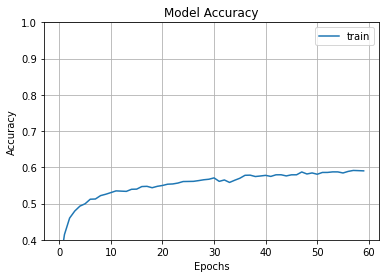

In [ ]:
fig2 = plt.gcf()
plt.plot(history_3.history['accuracy'])
plt.axis(ymin=0.4,ymax=1)
plt.grid()
plt.title('Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epochs')
plt.legend(['train'])
plt.show()

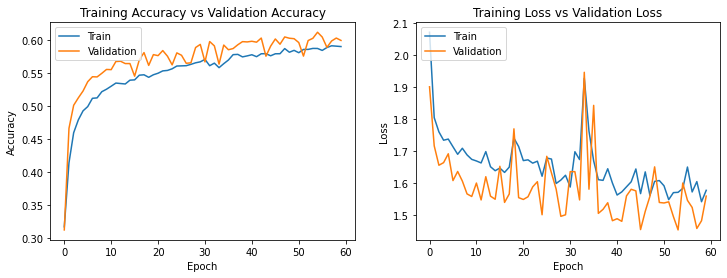

In [ ]:
fig2 , ax = plt.subplots(1,2)
train_acc = history_3.history['accuracy']
train_loss = history_3.history['loss']
fig2.set_size_inches(12,4)

ax[0].plot(history_3.history['accuracy'])
ax[0].plot(history_3.history['val_accuracy'])
ax[0].set_title('Training Accuracy vs Validation Accuracy')
ax[0].set_ylabel('Accuracy')
ax[0].set_xlabel('Epoch')
ax[0].legend(['Train', 'Validation'], loc='upper left')

ax[1].plot(history_3.history['loss'])
ax[1].plot(history_3.history['val_loss'])
ax[1].set_title('Training Loss vs Validation Loss')
ax[1].set_ylabel('Loss')
ax[1].set_xlabel('Epoch')
ax[1].legend(['Train', 'Validation'], loc='upper left')

plt.show()

### Still i am not happy with the result.

In [ ]:

# Evaluate the model on the test data
test_loss, test_acc = model_3.evaluate(train_generator)
print('Test accuracy:', test_acc)

449/449 [==============================] - 22s 50ms/step - loss: 1.4892 - accuracy: 0.6271
Test accuracy: 0.6271204352378845


In [ ]:
# Evaluate the model on the test data
test_loss, test_acc = model_3.evaluate(validation_generator)
print('Test accuracy:', test_acc)

113/113 [==============================] - 3s 23ms/step - loss: 1.5603 - accuracy: 0.5995
Test accuracy: 0.5994706153869629


## So now I am going to use Data Augmentation technique to and will increase size of data

['test', 'train']
['fearful', 'disgusted', 'angry', 'neutral', 'surprised', 'sad', 'happy']
['fearful', 'disgusted', 'angry', 'neutral', 'surprised', 'sad', 'happy']
Found 22968 images belonging to 7 classes.
Found 1432 images belonging to 7 classes.


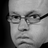

(48, 48)
Found 35887 files belonging to 2 classes.
Using 28710 files for training.


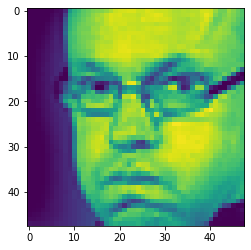

In [ ]:
# Extracting the dataset
zip_ref = zipfile.ZipFile("archive.zip", "r")
zip_ref.extractall()
zip_ref.close()

dataset_path = "/content/archive"

labels = os.listdir(dataset_path)
print(labels)

for label in labels:
    print(os.listdir(os.path.join(dataset_path, label)))  

# Preparing training and validation directories
train_dir = "/content/archive/train"
test_dir = "/content/archive/test"

# Defining ImageDataGenerator for data augmentation
img_size = 48
train_datagen = ImageDataGenerator(
    rescale = 1./255,
    rotation_range = 20,
    zoom_range = 0.2,
    width_shift_range = 0.1,
    height_shift_range = 0.1,
    shear_range = 0.2,
    horizontal_flip = True,
    vertical_flip = True,
    fill_mode = 'nearest',
    validation_split = 0.2
)

# Preparing training data using ImageDataGenerator
train_generator = train_datagen.flow_from_directory(
    directory = train_dir,
    target_size = (img_size, img_size),
    batch_size = 64,
    color_mode = "grayscale",
    class_mode = "categorical",
    subset = "training"
)

# Preparing validation data using ImageDataGenerator
validation_datagen = ImageDataGenerator(
    rescale = 1./255,
    validation_split = 0.2
)

validation_generator = validation_datagen.flow_from_directory(
    directory = test_dir,
    target_size = (img_size, img_size),
    batch_size = 64,
    color_mode = "grayscale",
    class_mode = "categorical",
    subset = "validation"
)

# Loading an image for visualization
img = Image.open('/content/archive/test/angry/im106.png')
img.show()

img = load_img('/content/archive/test/angry/im106.png', target_size=(48, 48), color_mode="grayscale")
img = np.array(img)
plt.imshow(img)
print(img.shape)

# Preparing training data using tf.keras.preprocessing.image_dataset_from_directory
train_ds = tf.keras.preprocessing.image_dataset_from_directory(
    directory = dataset_path,
    validation_split = 0.2,
    subset = "training",
    seed = 123,
    image_size = (224, 224),
    batch_size = 32
)


(48, 48)
1/1 [==============================] - 0s 22ms/step
[0.0, 0.0, 9.047387e-16, 0.0, 1.0, 0.0, 0.0]
Neutral


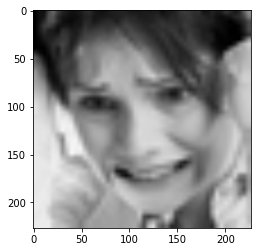

In [ ]:
from tensorflow.keras.preprocessing.image import load_img, img_to_array

img = load_img("../content/archive/test/fearful/im1002.png",target_size = (48,48),color_mode = "grayscale")
img = np.array(img)
plt.imshow(img)
print(img.shape)

import cv2
import numpy as np

label_dict = {0:'Angry',1:'Disgust',2:'Fear',3:'Happy',4:'Neutral',5:'Sad',6:'Surprise'}

img = cv2.imread('/content/archive/test/fearful/im1002.png', cv2.IMREAD_GRAYSCALE)

if img is None:
    raise ValueError('Failed to load image. Check if image path is correct and image file exists.')
elif img.size == 0:
    raise ValueError('Input image is empty or has invalid dimensions. Check the image file.')

img = cv2.resize(img, (227, 227))
img = np.repeat(img[..., np.newaxis], 3, -1)

result = model.predict(np.array([img]))
result = list(result[0])
print(result)

img_index = result.index(max(result))
print(label_dict[img_index])

plt.imshow(img)
plt.show()


In [ ]:
# Creating and compiling the model
from tensorflow.keras.optimizers import Adam, RMSprop, SGD, Adamax

model_4 = Sequential()
model_4.add(Conv2D(32, kernel_size = (3, 3), padding = 'same', activation = 'relu', input_shape = (48, 48, 1)))
model_4.add(Conv2D(64, (3, 3), padding = 'same', activation = 'relu'))
model_4.add(BatchNormalization())
model_4.add(MaxPool2D(pool_size = (2, 2)))
model_4.add(Dropout(0.25))

model_4.add(Conv2D(128, (5, 5), padding = 'same', activation = 'relu'))
model_4.add(Conv2D(256, (5, 5), padding = 'same', activation = 'relu'))
model_4.add(Conv2D(512, (5, 5), padding = 'same', activation = 'swish'))
model_4.add(BatchNormalization())
model_4.add(MaxPool2D(pool_size = (2, 2)))
model_4.add(Dropout(0.25))

model_4.add(Flatten()),
model_4.add(Dense(256, activation='relu'))
model_4.add(BatchNormalization())
model_4.add(Dropout(0.5))

model_4.add(Dense(128, activation = 'relu'))
model_4.add(BatchNormalization())
model_4.add(Dropout(0.5))

model_4.add(Dense(7, activation = 'softmax'))

model_4.summary()

Model: "sequential_15"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_60 (Conv2D)          (None, 48, 48, 32)        320       
                                                                 
 conv2d_61 (Conv2D)          (None, 48, 48, 64)        18496     
                                                                 
 batch_normalization_56 (Bat  (None, 48, 48, 64)       256       
 chNormalization)                                                
                                                                 
 max_pooling2d_35 (MaxPoolin  (None, 24, 24, 64)       0         
 g2D)                                                            
                                                                 
 dropout_56 (Dropout)        (None, 24, 24, 64)        0         
                                                                 
 conv2d_62 (Conv2D)          (None, 24, 24, 128)     

In [ ]:
optimizer = Adam(lr=0.001)
model_4.compile(optimizer = optimizer, loss = 'categorical_crossentropy', metrics = ['accuracy'])

## Here I am going for 100 epochs with batch size of 40 

In [ ]:
epochs= 100
batch_size=40
history_4 = model_4.fit(x = train_generator,epochs = epochs,validation_data = validation_generator)

Epoch 1/100
359/359 [==============================] - 77s 94ms/step - loss: 2.2728 - accuracy: 0.1957 - val_loss: 1.8245 - val_accuracy: 0.2465
Epoch 2/100
359/359 [==============================] - 34s 96ms/step - loss: 1.8999 - accuracy: 0.2323 - val_loss: 1.7758 - val_accuracy: 0.2689
Epoch 3/100
359/359 [==============================] - 34s 95ms/step - loss: 1.8164 - accuracy: 0.2522 - val_loss: 1.7802 - val_accuracy: 0.2709
Epoch 4/100
359/359 [==============================] - 33s 92ms/step - loss: 1.7824 - accuracy: 0.2668 - val_loss: 1.9309 - val_accuracy: 0.2493
Epoch 5/100
359/359 [==============================] - 35s 97ms/step - loss: 1.7334 - accuracy: 0.2985 - val_loss: 1.6452 - val_accuracy: 0.3331
Epoch 6/100
359/359 [==============================] - 34s 95ms/step - loss: 1.6903 - accuracy: 0.3207 - val_loss: 1.6060 - val_accuracy: 0.3624
Epoch 7/100
359/359 [==============================] - 34s 95ms/step - loss: 1.6508 - accuracy: 0.3440 - val_loss: 1.6774 - val_ac

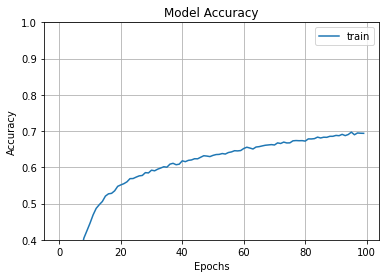

In [ ]:
fig3 = plt.gcf()
plt.plot(history_4.history['accuracy'])
plt.axis(ymin=0.4,ymax=1)
plt.grid()
plt.title('Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epochs')
plt.legend(['train'])
plt.show()

### WOW! At least I got something interesting here. I got accuracy around 70% which highest amongst all model I have tried.

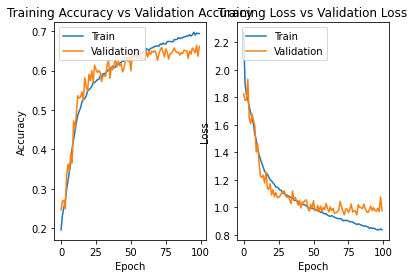

In [ ]:
fig3 , ax = plt.subplots(1,2)
train_acc = history_4.history['accuracy']
train_loss = history_4.history['loss']
fig2.set_size_inches(12,4)

ax[0].plot(history_4.history['accuracy'])
ax[0].plot(history_4.history['val_accuracy'])
ax[0].set_title('Training Accuracy vs Validation Accuracy')
ax[0].set_ylabel('Accuracy')
ax[0].set_xlabel('Epoch')
ax[0].legend(['Train', 'Validation'], loc='upper left')

ax[1].plot(history_4.history['loss'])
ax[1].plot(history_4.history['val_loss'])
ax[1].set_title('Training Loss vs Validation Loss')
ax[1].set_ylabel('Loss')
ax[1].set_xlabel('Epoch')
ax[1].legend(['Train', 'Validation'], loc='upper left')

plt.show()

In [33]:
pip install pyvirtualdisplay


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [34]:
!apt update
!apt install -y xvfb python-opengl ffmpeg

from pyvirtualdisplay import Display
display = Display(visible=0, size=(1, 1))
display.start()


Get:1 http://ppa.launchpad.net/c2d4u.team/c2d4u4.0+/ubuntu focal InRelease [18.1 kB]
Hit:2 http://ppa.launchpad.net/cran/libgit2/ubuntu focal InRelease
Get:3 https://cloud.r-project.org/bin/linux/ubuntu focal-cran40/ InRelease [3,622 B]
Hit:4 http://ppa.launchpad.net/deadsnakes/ppa/ubuntu focal InRelease
Hit:5 http://ppa.launchpad.net/graphics-drivers/ppa/ubuntu focal InRelease
Hit:6 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2004/x86_64  InRelease
Hit:7 http://ppa.launchpad.net/ubuntugis/ppa/ubuntu focal InRelease
Get:8 http://security.ubuntu.com/ubuntu focal-security InRelease [114 kB]
Hit:9 http://archive.ubuntu.com/ubuntu focal InRelease
Get:10 http://archive.ubuntu.com/ubuntu focal-updates InRelease [114 kB]
Get:11 http://ppa.launchpad.net/c2d4u.team/c2d4u4.0+/ubuntu focal/main Sources [2,412 kB]
Get:12 http://archive.ubuntu.com/ubuntu focal-backports InRelease [108 kB]
Get:13 http://ppa.launchpad.net/c2d4u.team/c2d4u4.0+/ubuntu focal/main amd64 Packages [1,143

## In the last step I am Going to connect Open Cv and used my model which I have saved earlier to use as a Pre-trained model .

###I have uploaded 4 sec video which I Hvae recoreded to check the accuracy of he model.

1/1 [==============================] - 0s 256ms/step


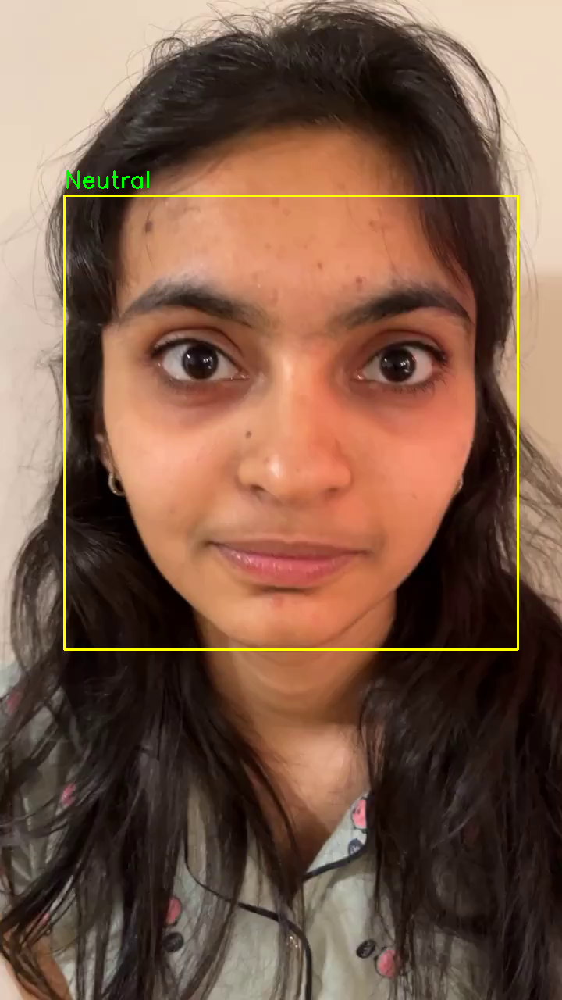

1/1 [==============================] - 0s 27ms/step


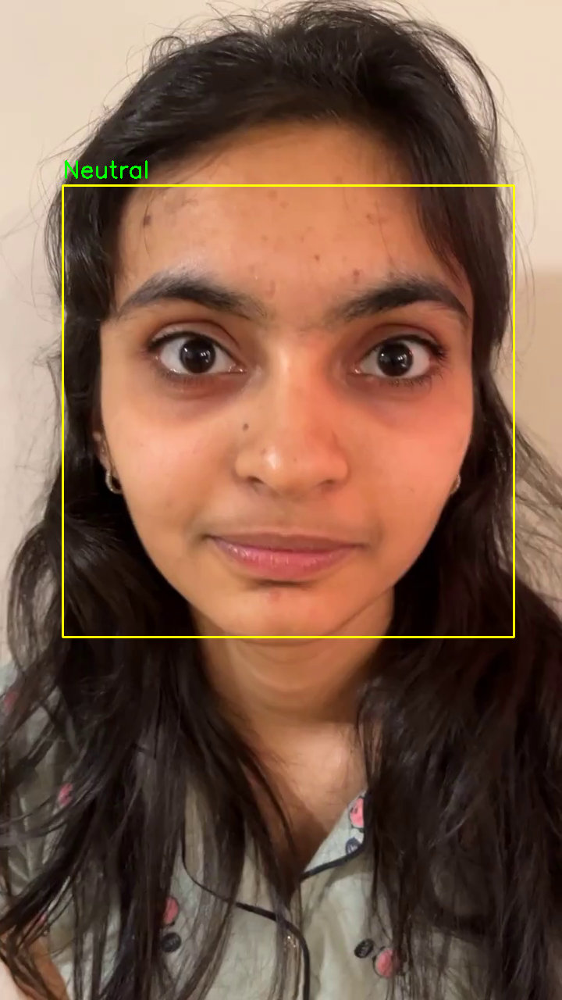

1/1 [==============================] - 0s 25ms/step


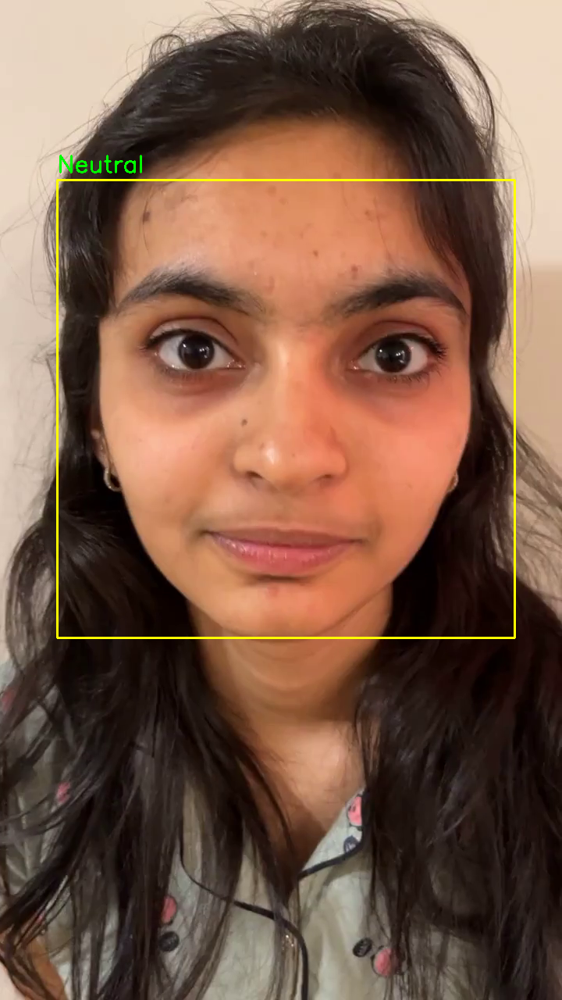

1/1 [==============================] - 0s 22ms/step


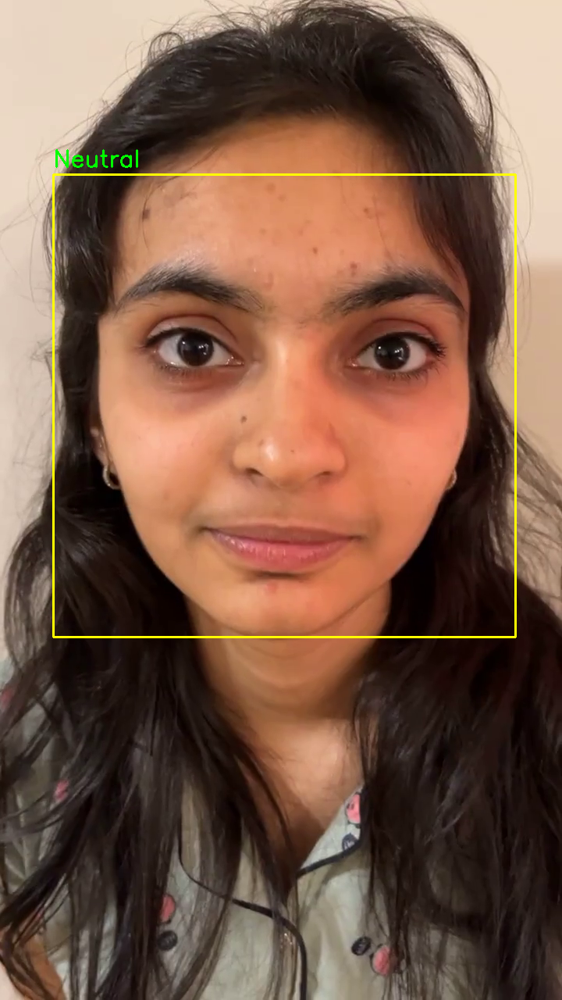

1/1 [==============================] - 0s 27ms/step


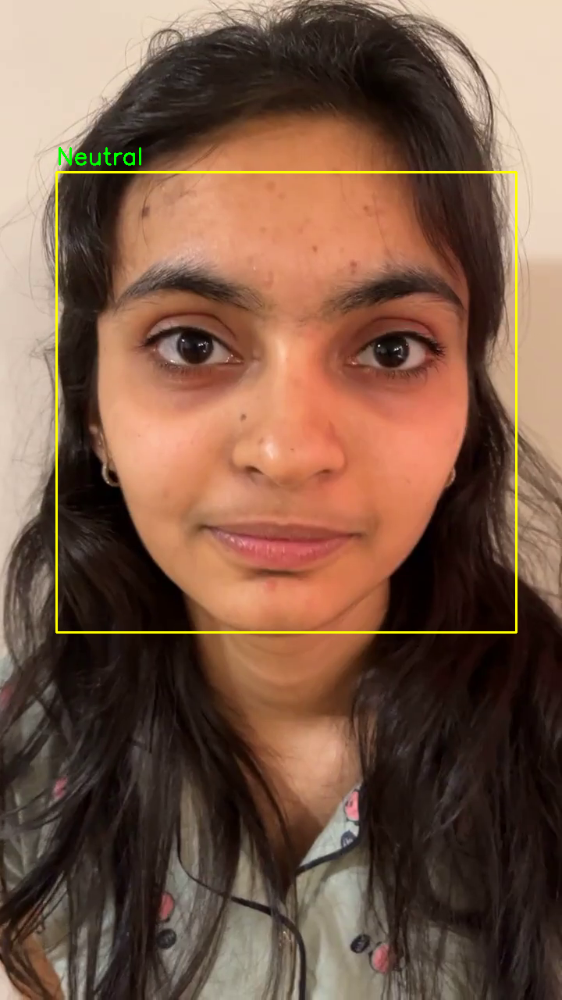

1/1 [==============================] - 0s 25ms/step


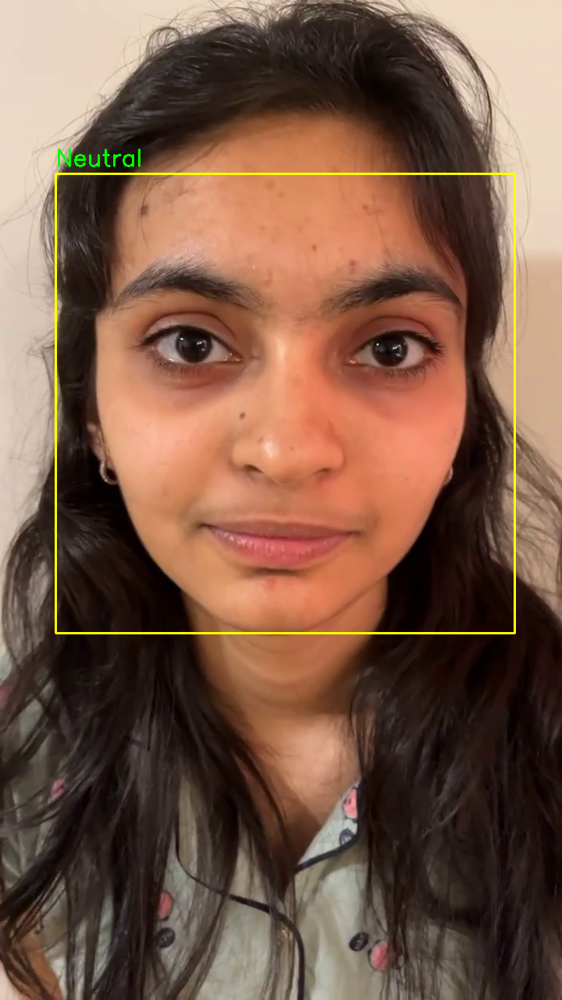

1/1 [==============================] - 0s 24ms/step


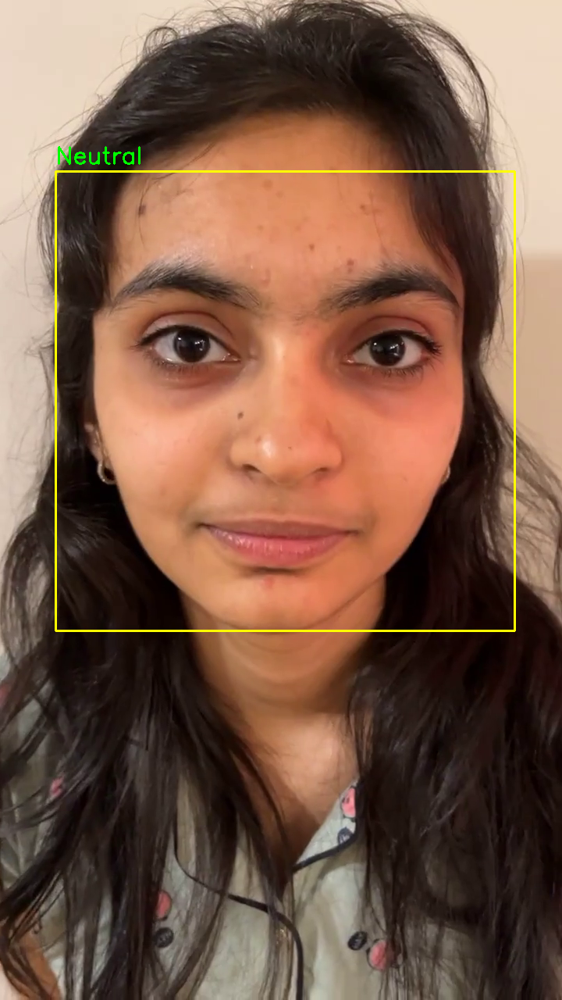

1/1 [==============================] - 0s 23ms/step


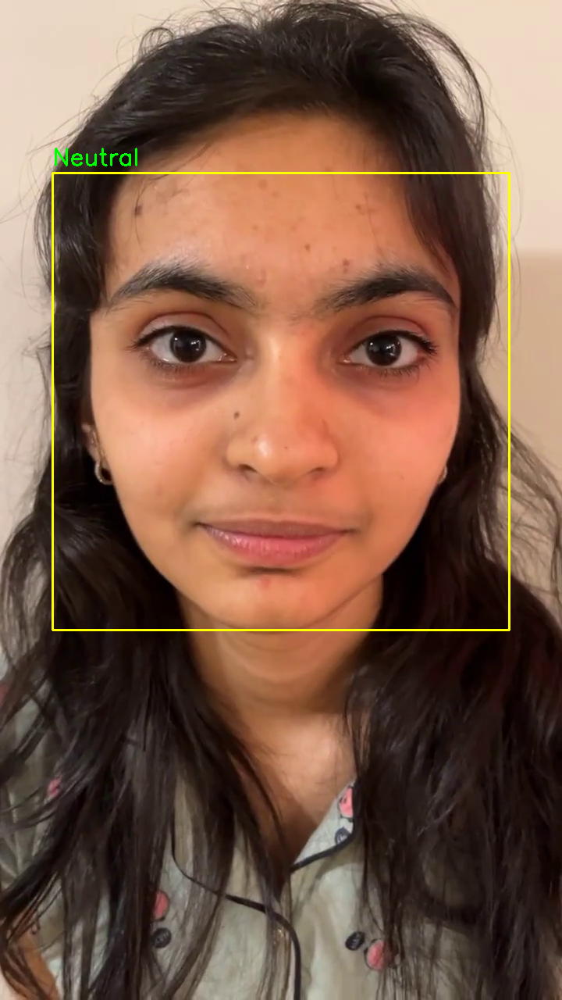

1/1 [==============================] - 0s 26ms/step


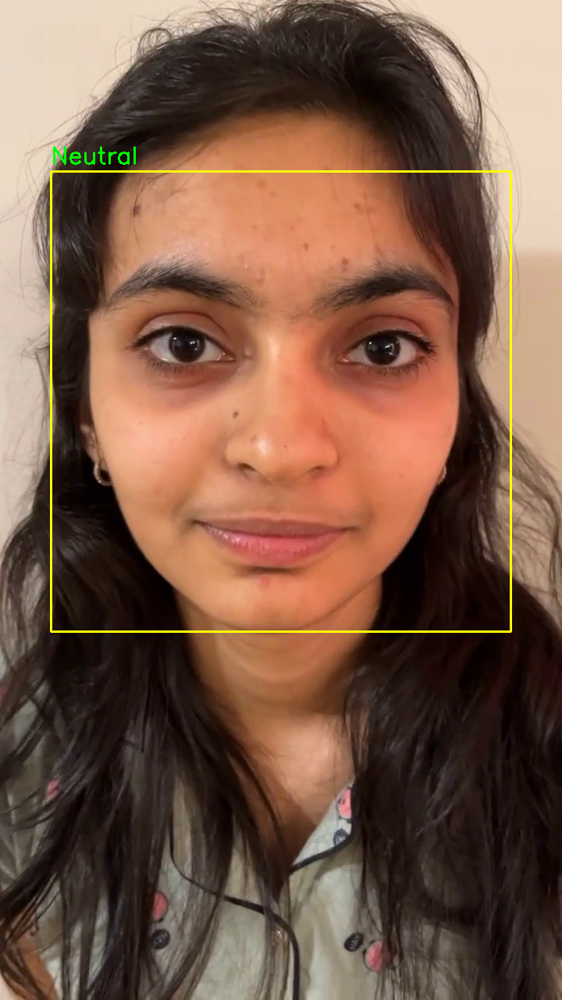

1/1 [==============================] - 0s 54ms/step


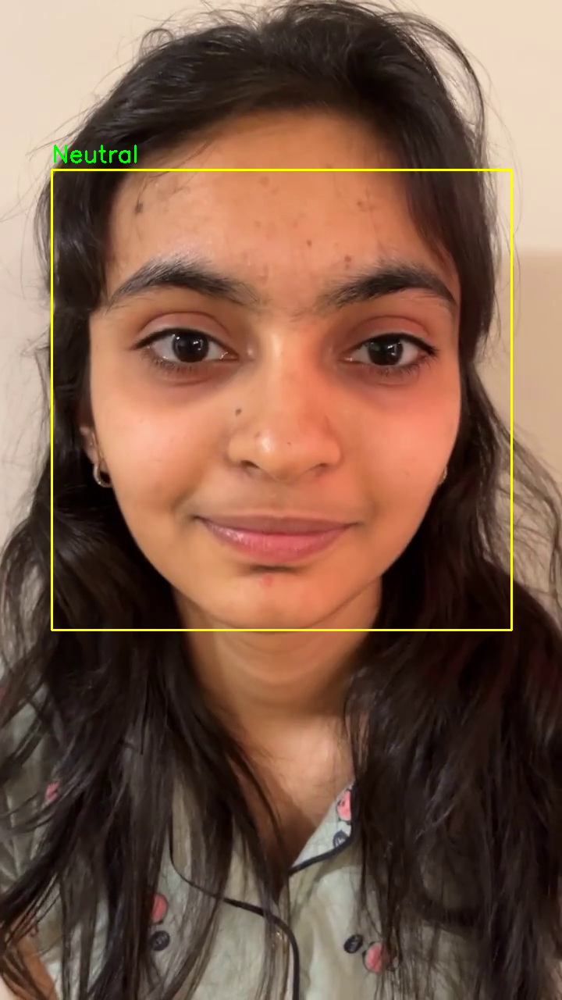

1/1 [==============================] - 0s 37ms/step


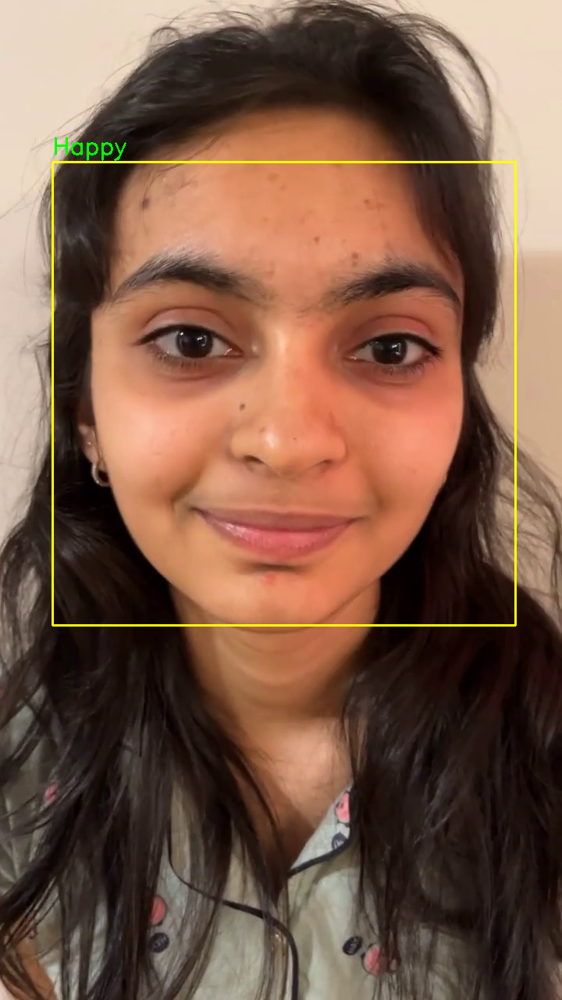

1/1 [==============================] - 0s 36ms/step


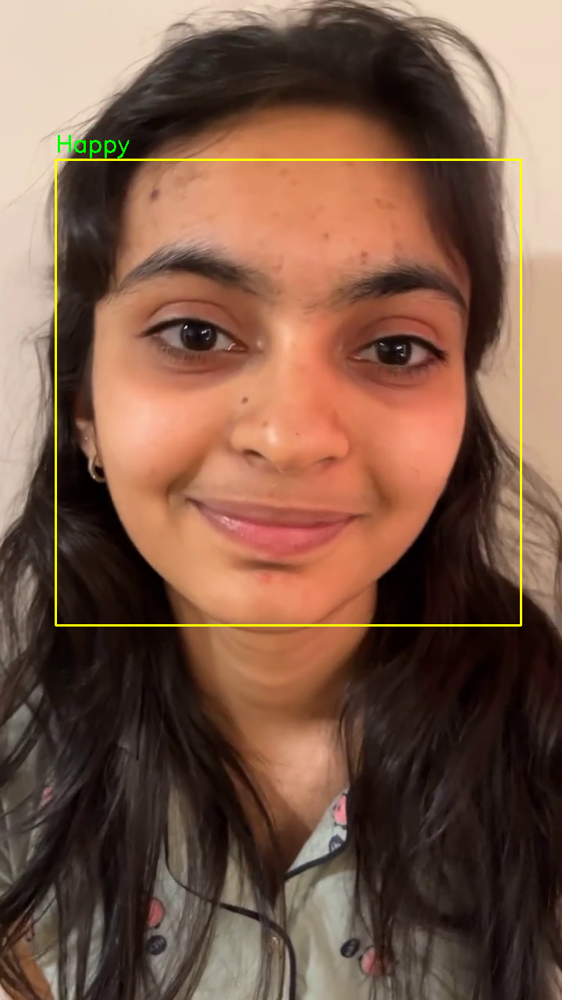

1/1 [==============================] - 0s 49ms/step


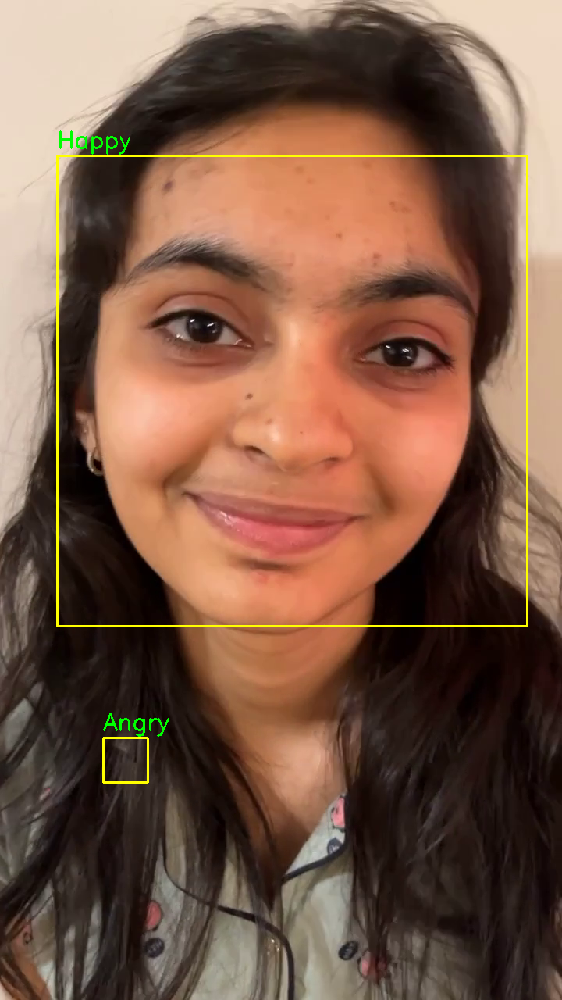

1/1 [==============================] - 0s 57ms/step


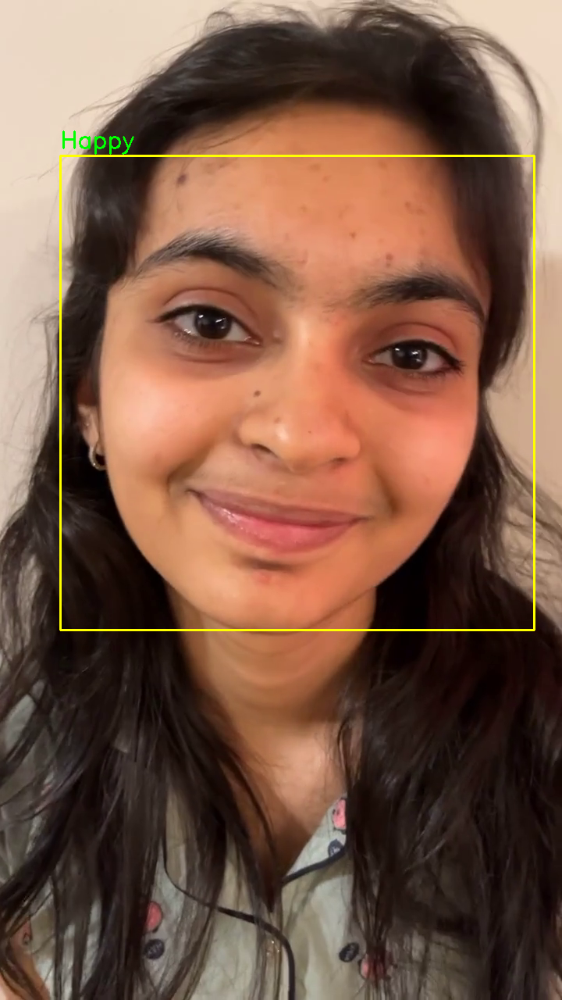

1/1 [==============================] - 0s 52ms/step


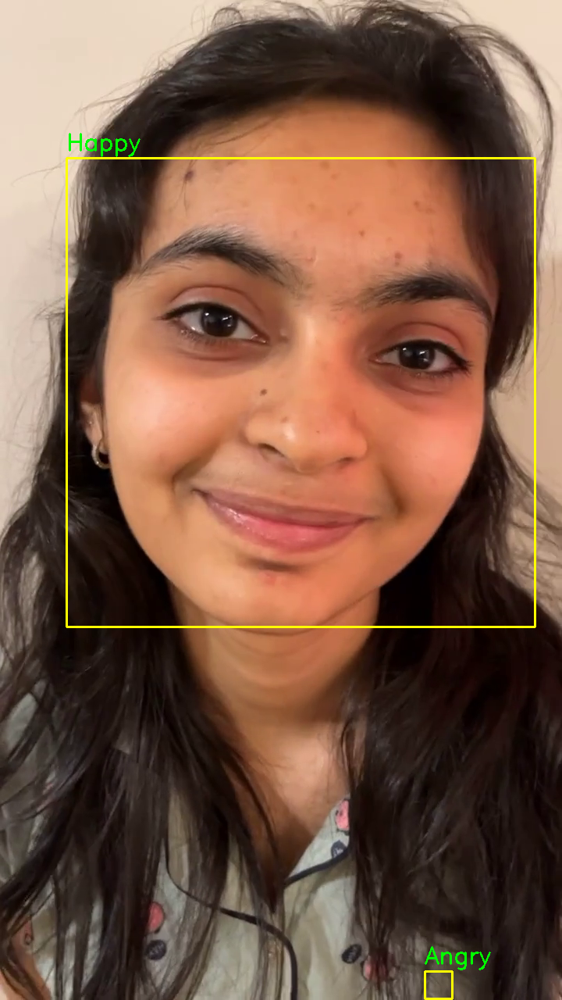

1/1 [==============================] - 0s 36ms/step


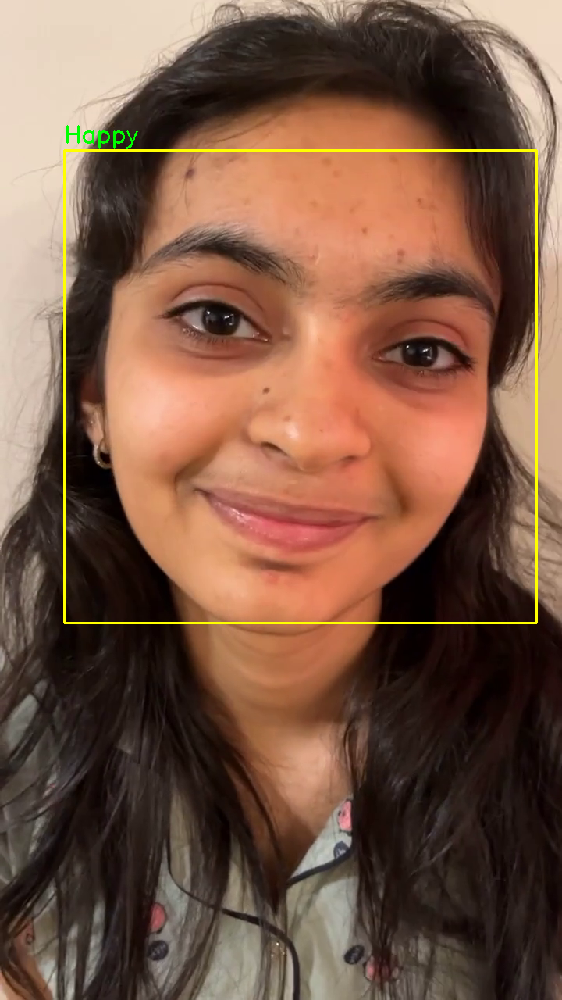

1/1 [==============================] - 0s 39ms/step


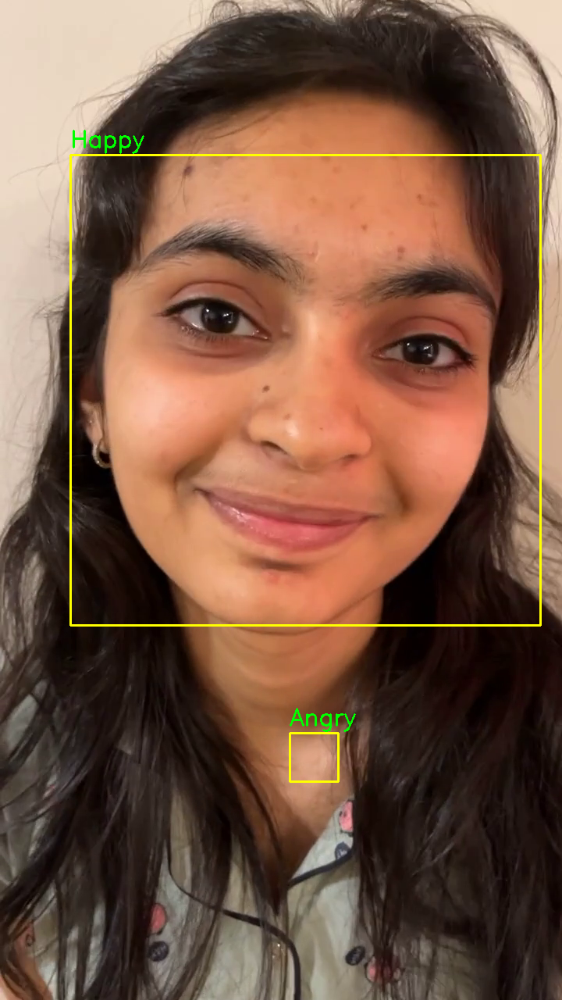

1/1 [==============================] - 0s 40ms/step


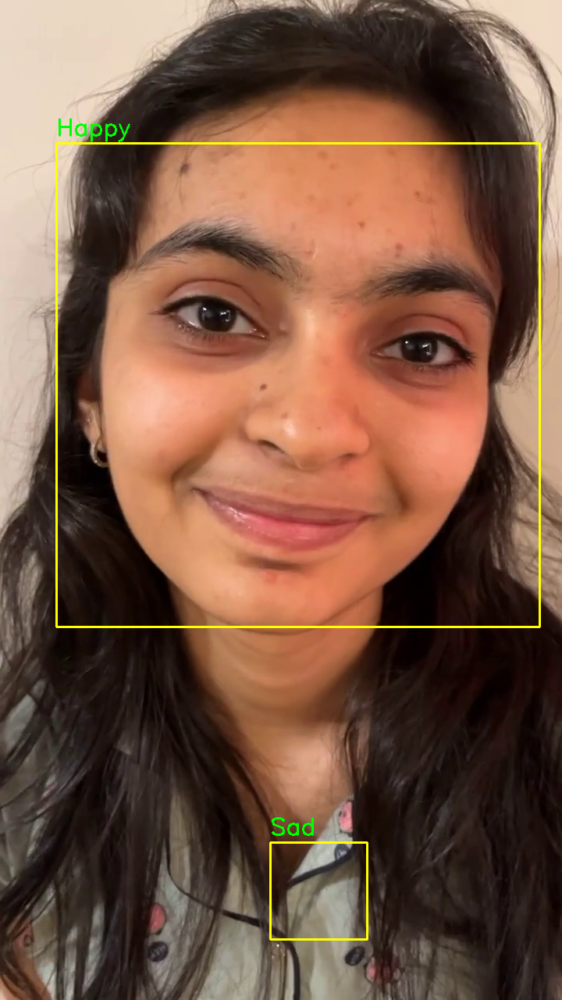

1/1 [==============================] - 0s 36ms/step


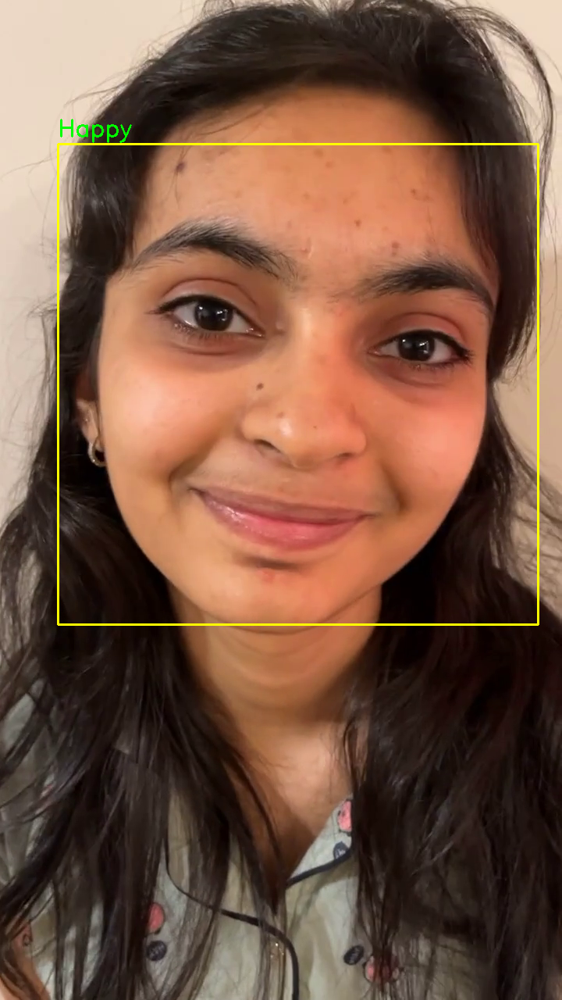

1/1 [==============================] - 0s 56ms/step


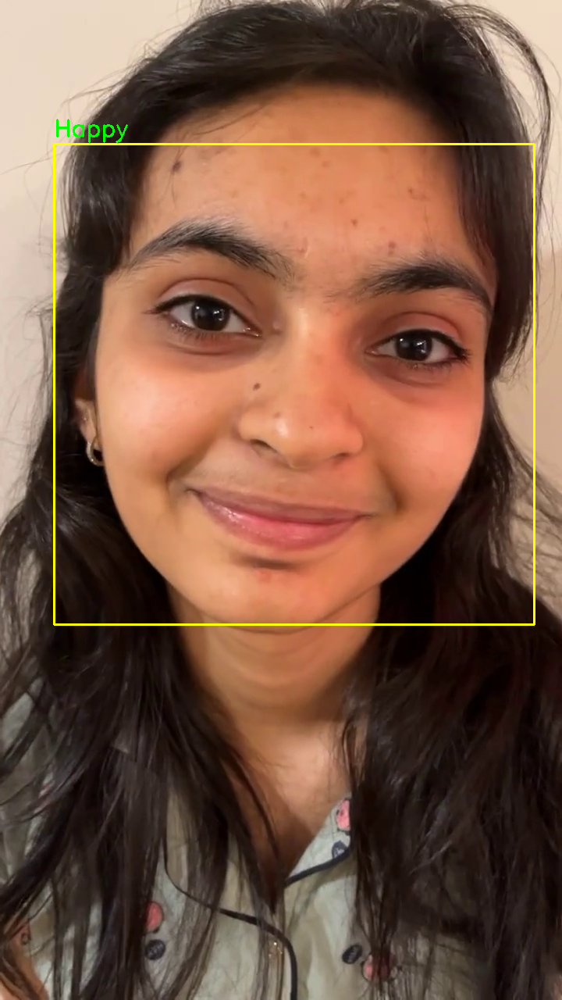

1/1 [==============================] - 0s 37ms/step


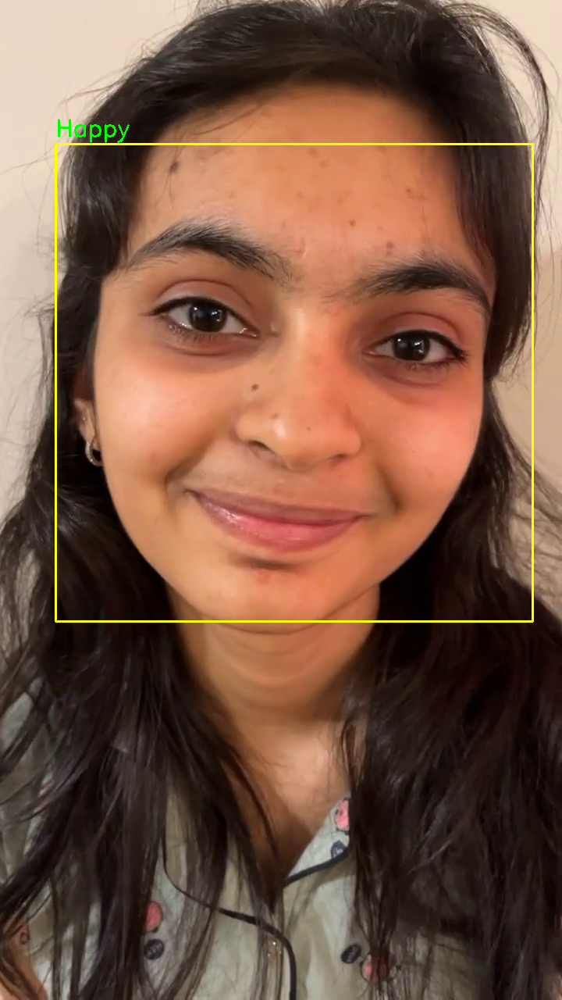

1/1 [==============================] - 0s 36ms/step


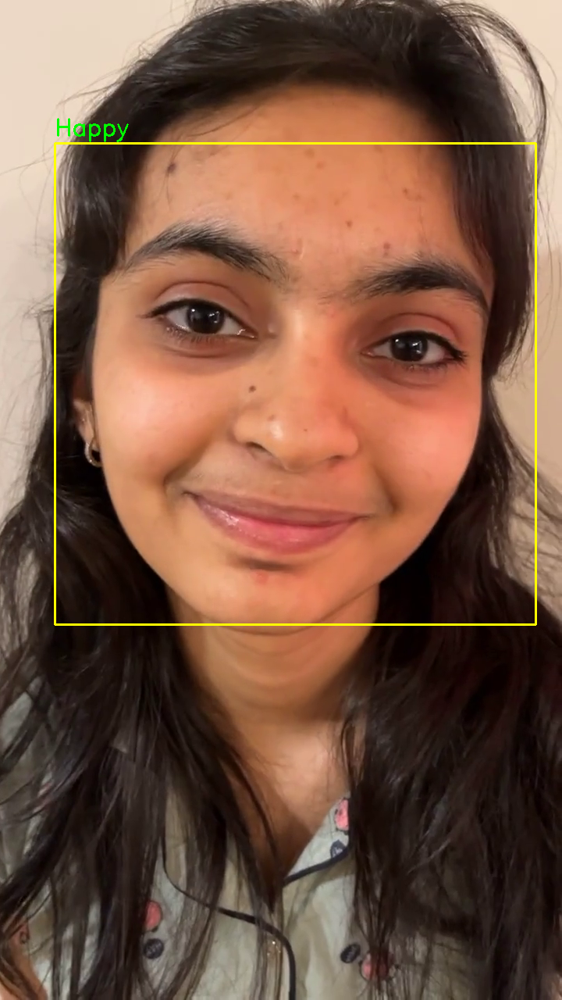

1/1 [==============================] - 0s 32ms/step


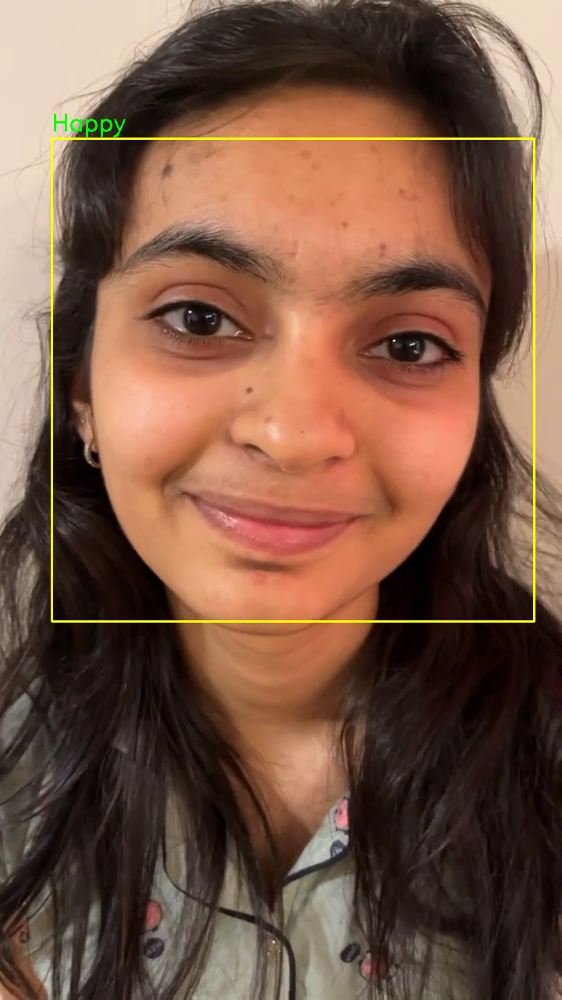

1/1 [==============================] - 0s 35ms/step


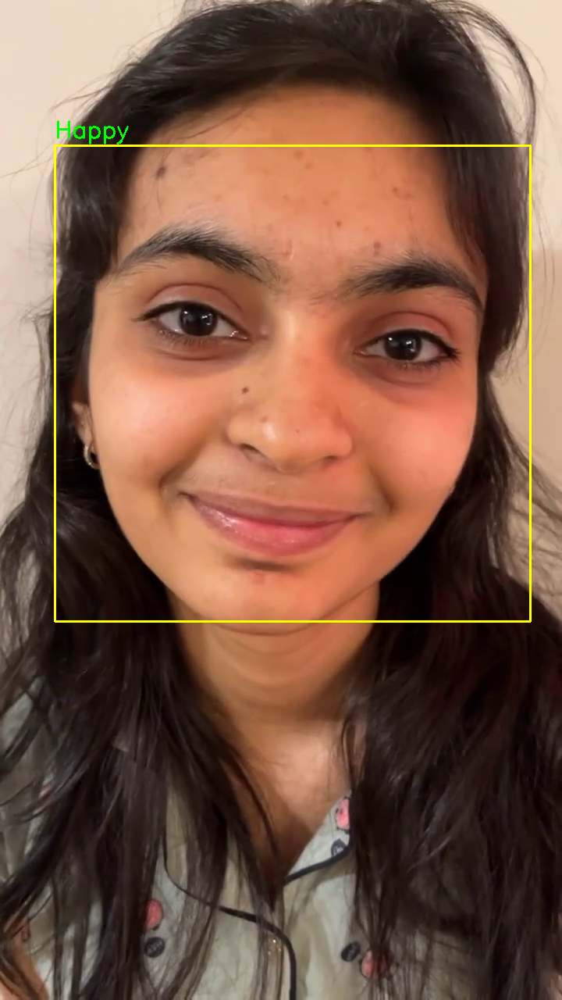

1/1 [==============================] - 0s 36ms/step


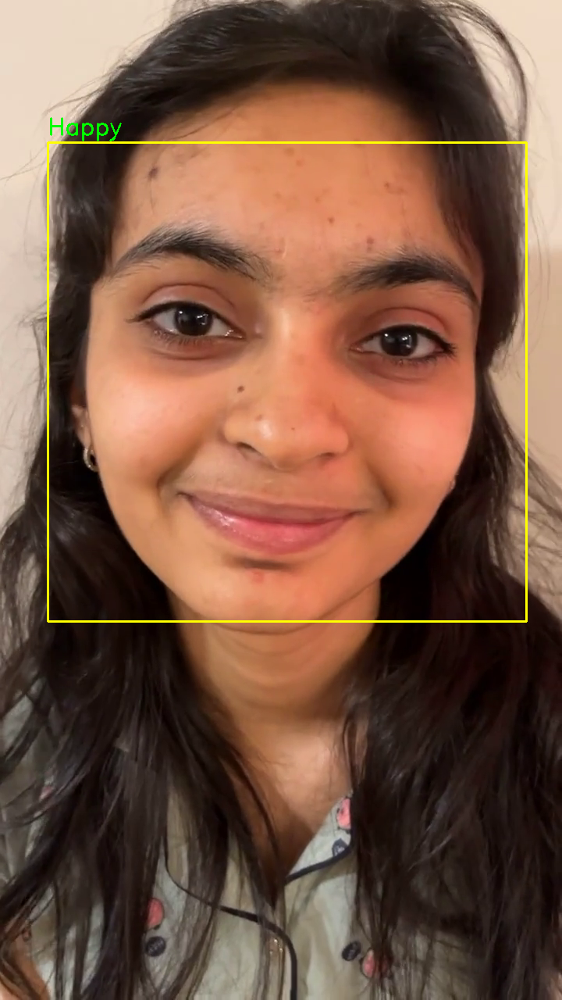

1/1 [==============================] - 0s 33ms/step


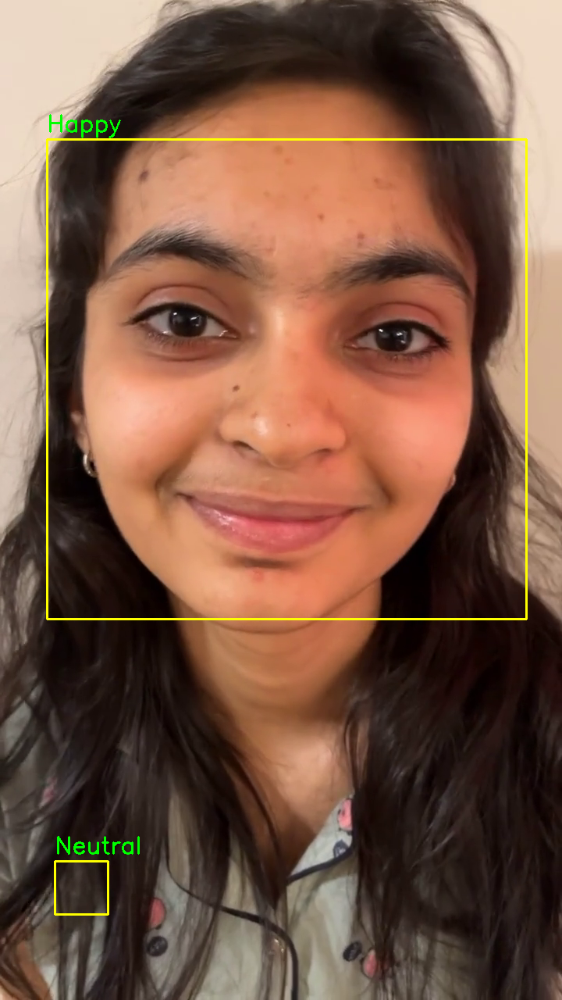

1/1 [==============================] - 0s 43ms/step


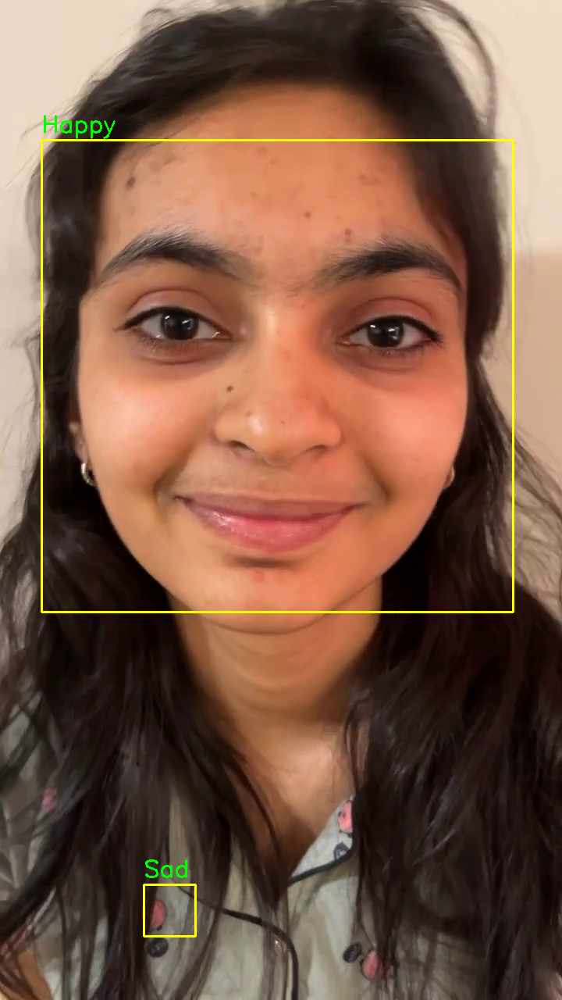

1/1 [==============================] - 0s 71ms/step


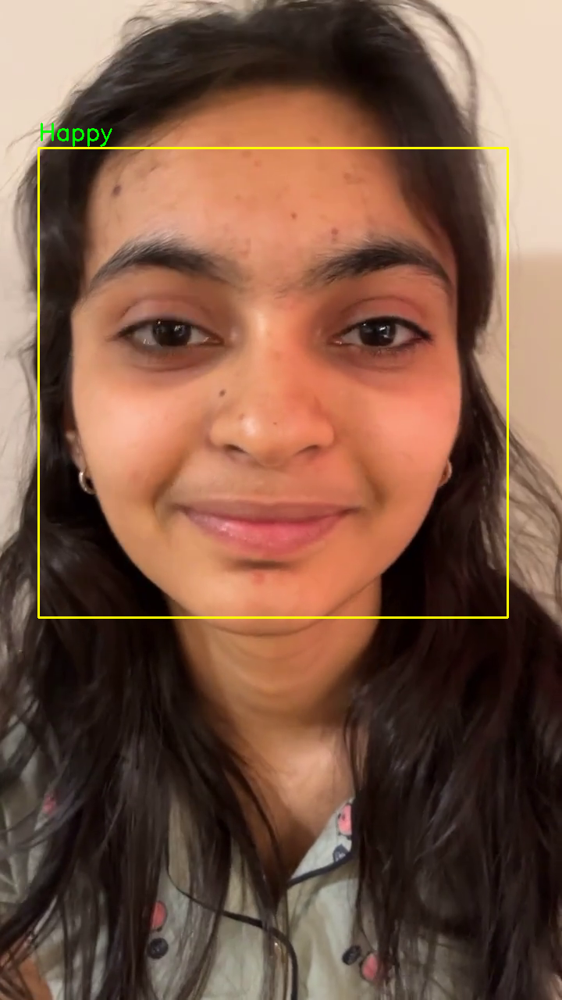

1/1 [==============================] - 0s 56ms/step


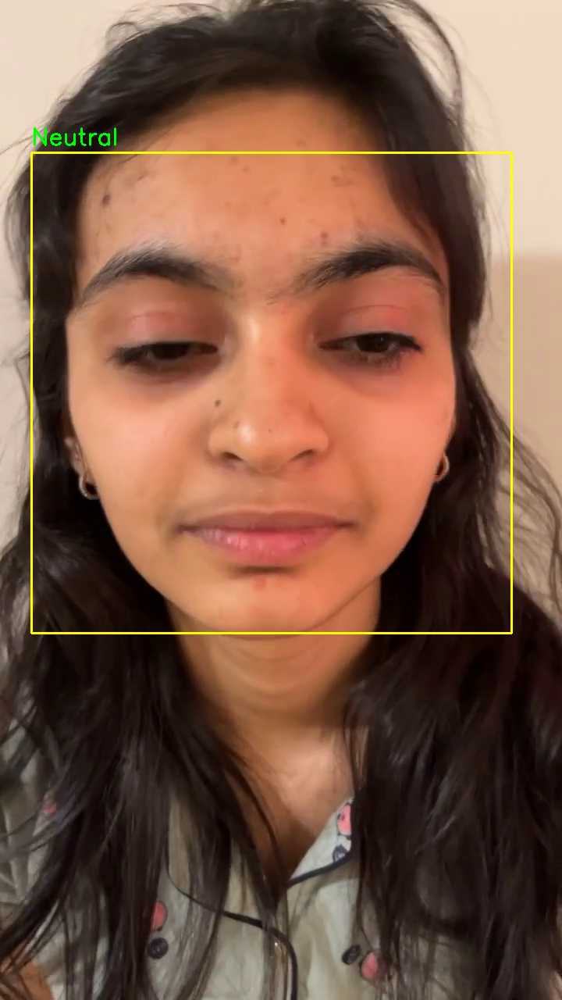

1/1 [==============================] - 0s 55ms/step


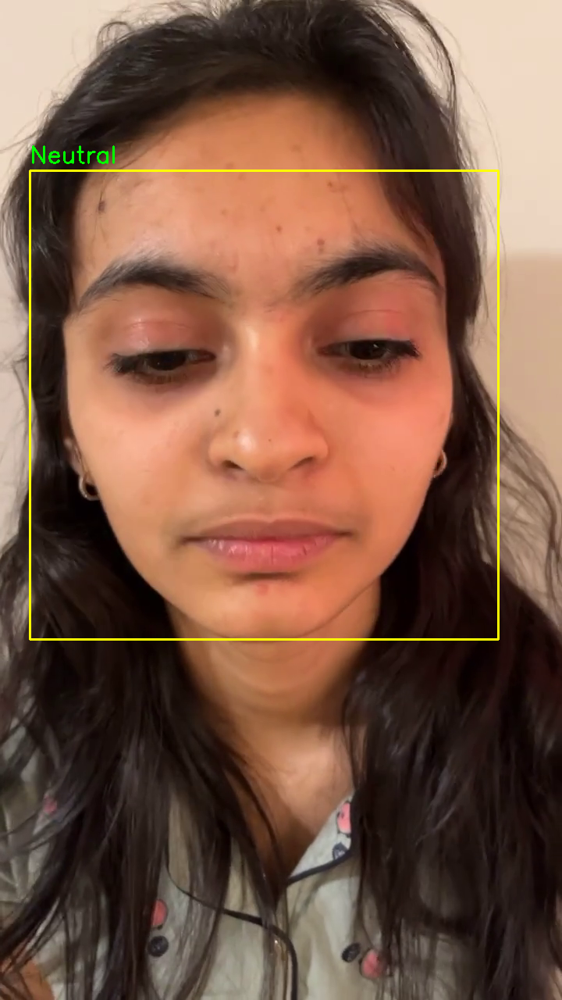

1/1 [==============================] - 0s 58ms/step


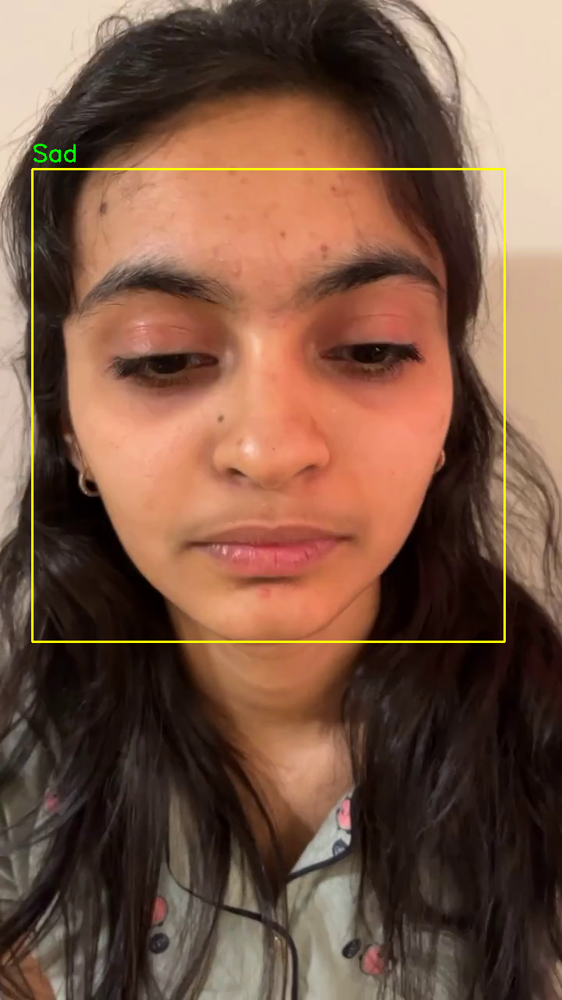

1/1 [==============================] - 0s 56ms/step


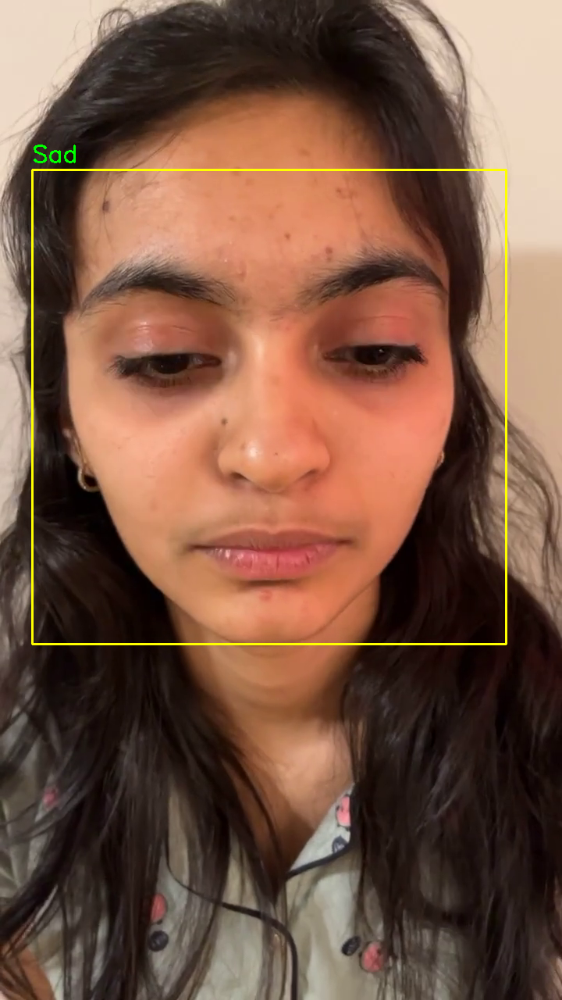

1/1 [==============================] - 0s 44ms/step


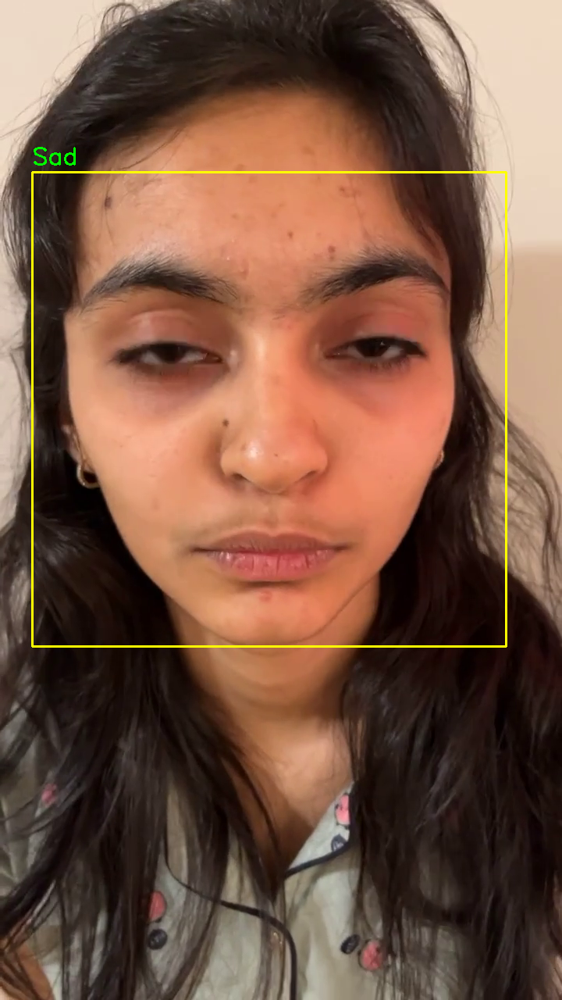

1/1 [==============================] - 0s 57ms/step


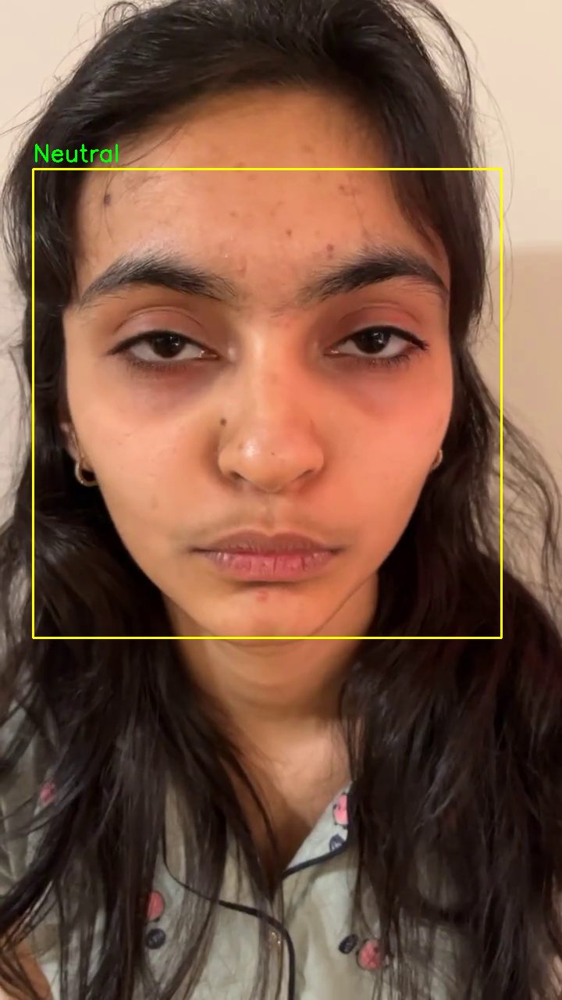

1/1 [==============================] - 0s 31ms/step


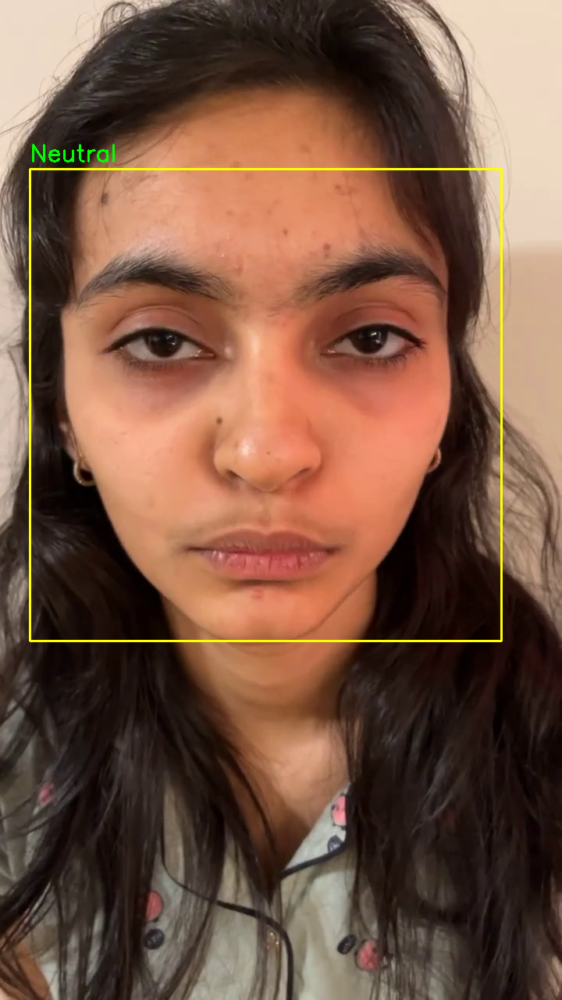

1/1 [==============================] - 0s 32ms/step


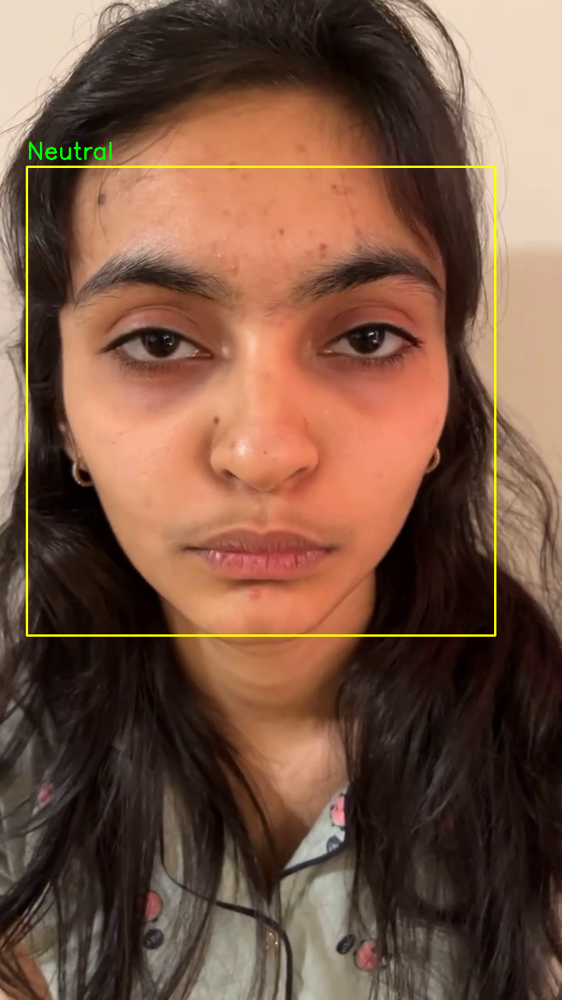

1/1 [==============================] - 0s 37ms/step


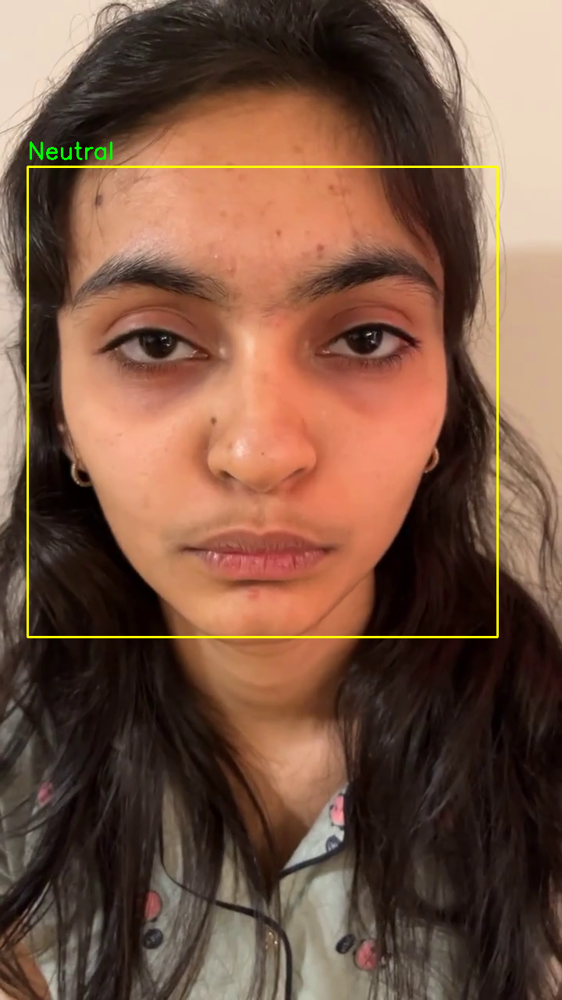

1/1 [==============================] - 0s 38ms/step


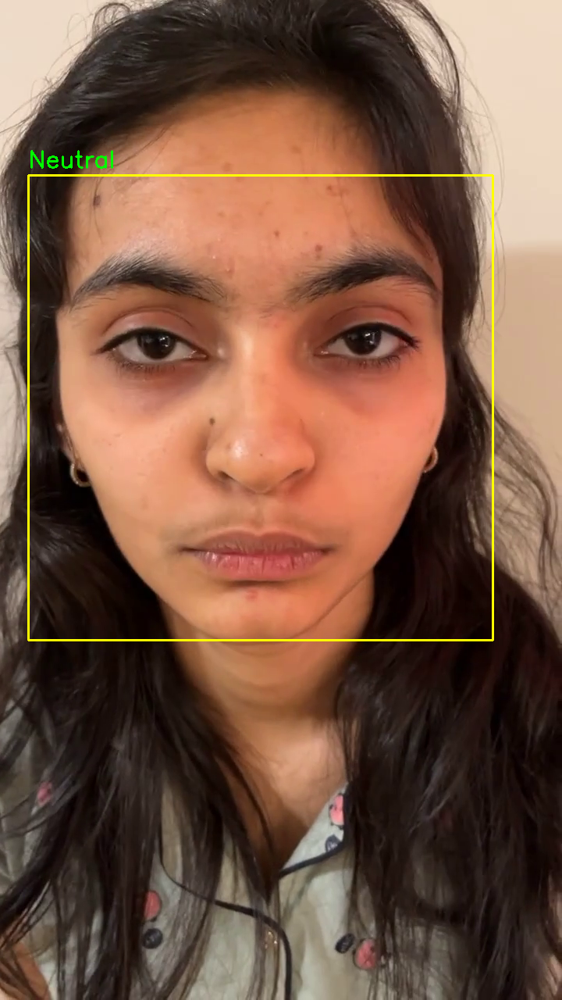

1/1 [==============================] - 0s 37ms/step


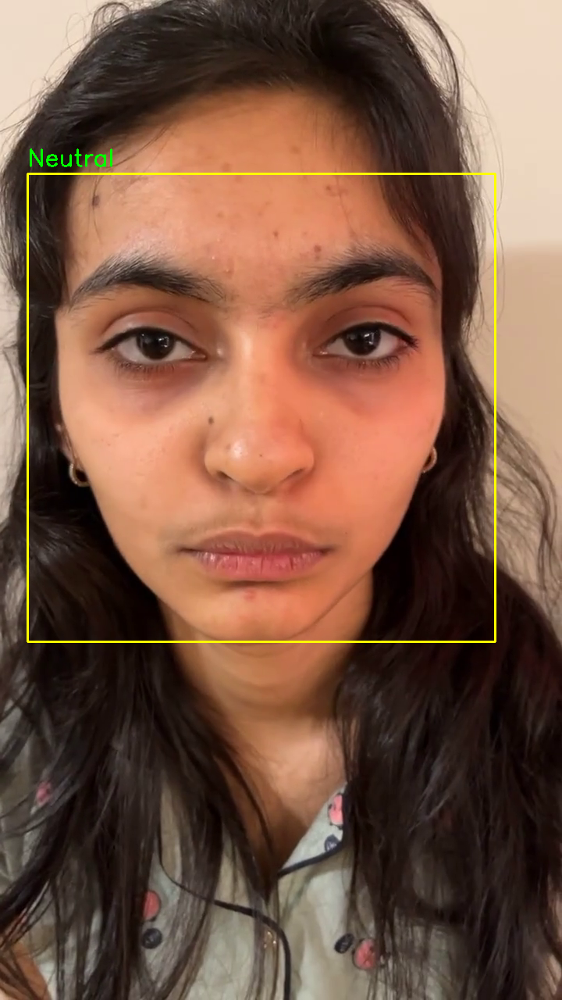

1/1 [==============================] - 0s 38ms/step


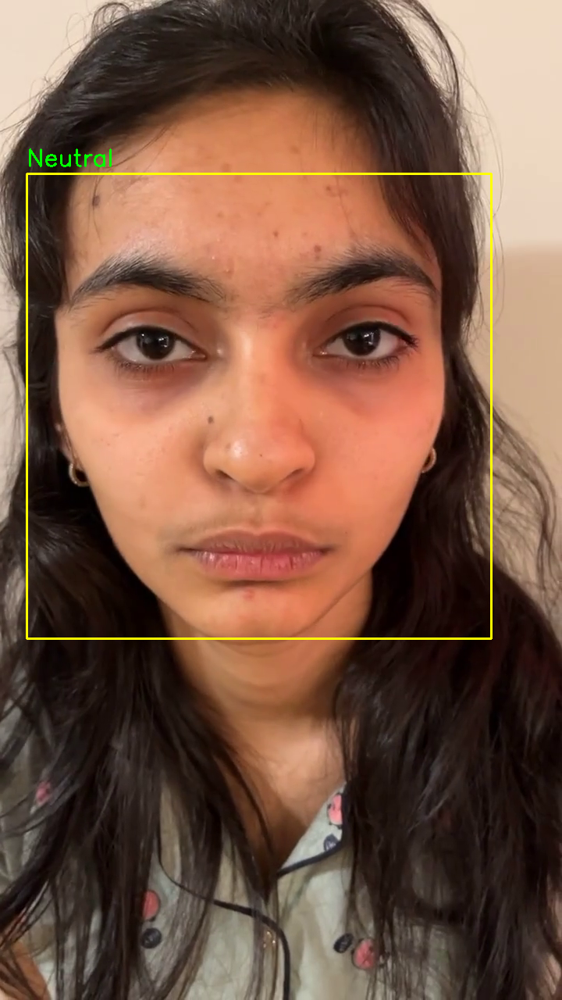

1/1 [==============================] - 0s 48ms/step


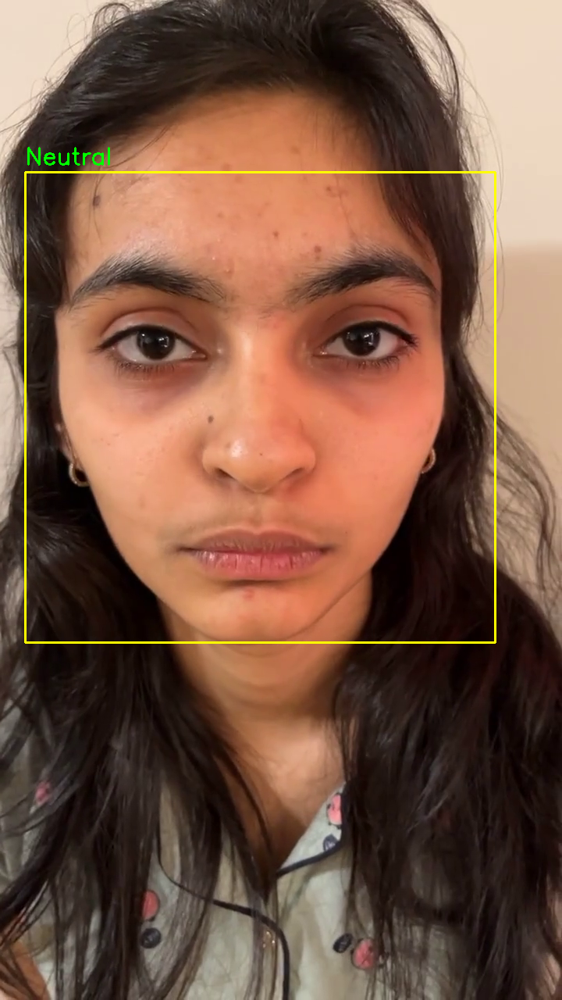

1/1 [==============================] - 0s 86ms/step


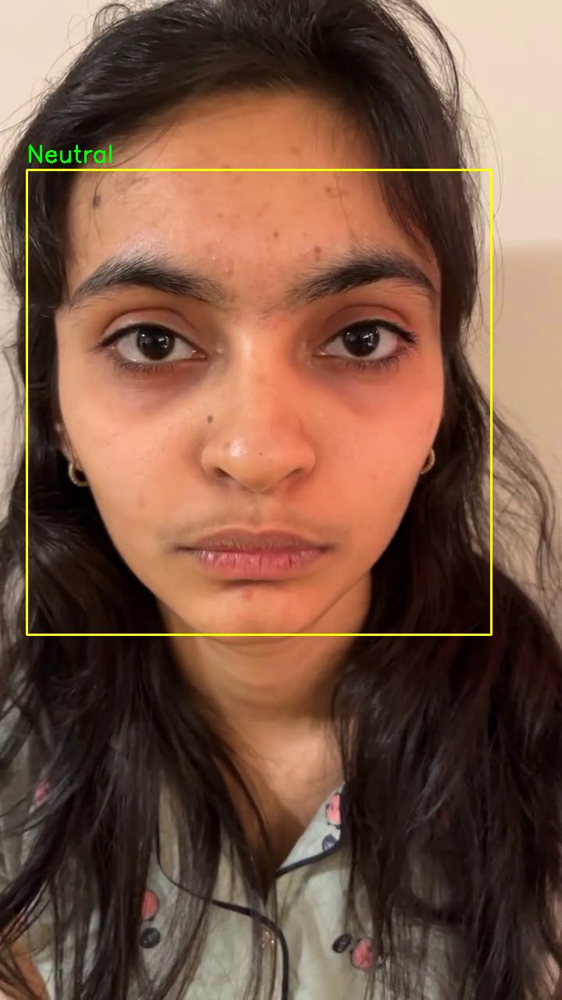

1/1 [==============================] - 0s 54ms/step


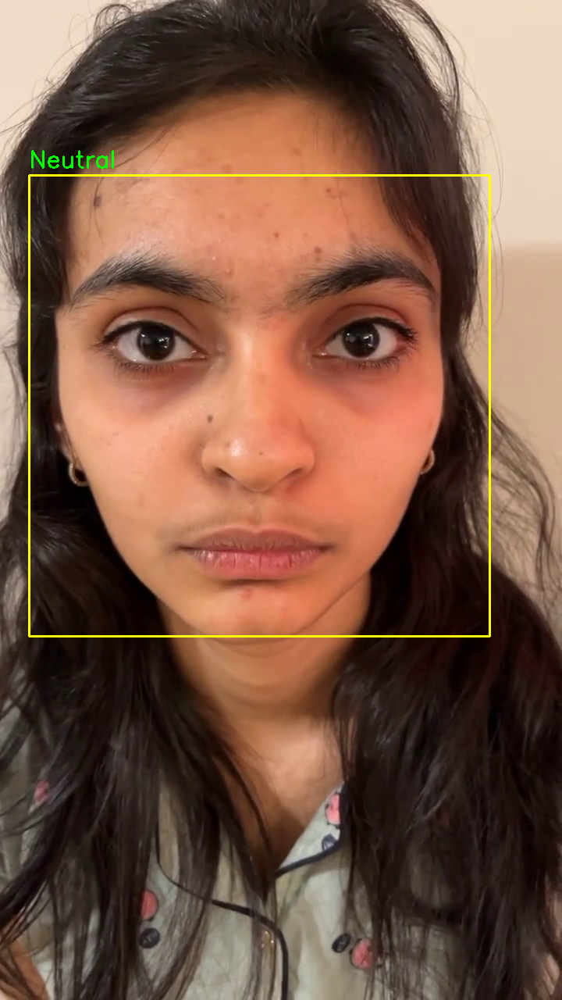

1/1 [==============================] - 0s 75ms/step


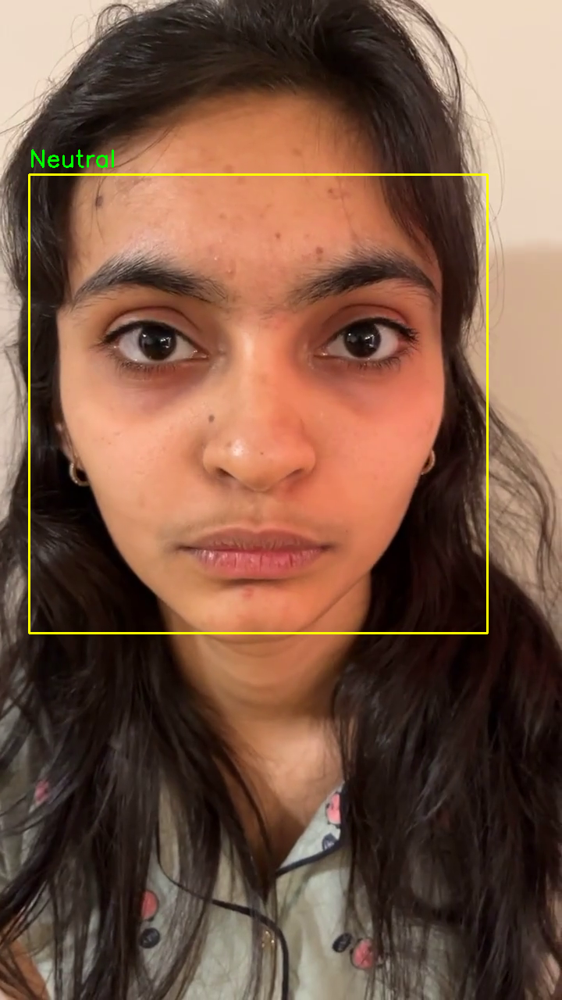

1/1 [==============================] - 0s 78ms/step


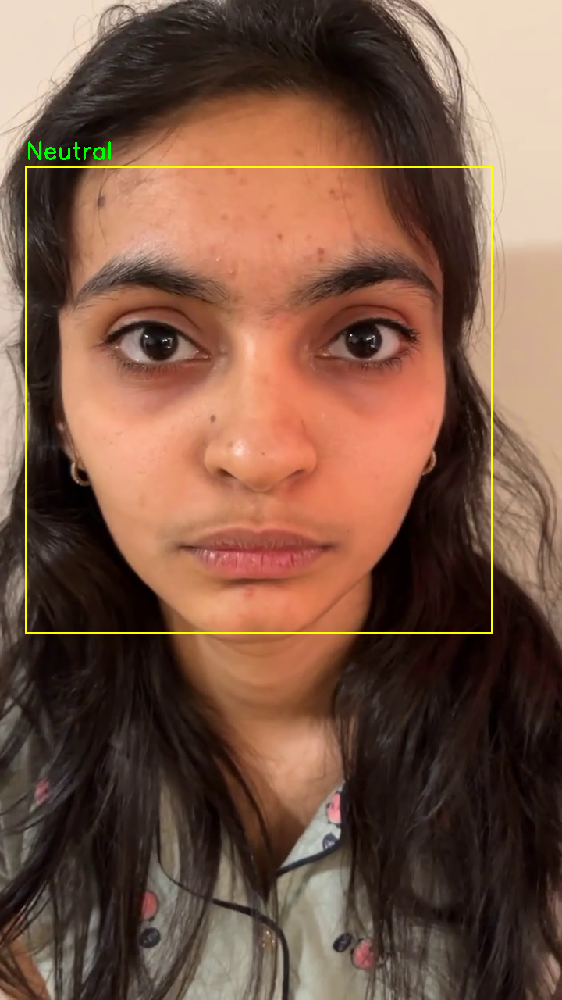

1/1 [==============================] - 0s 61ms/step


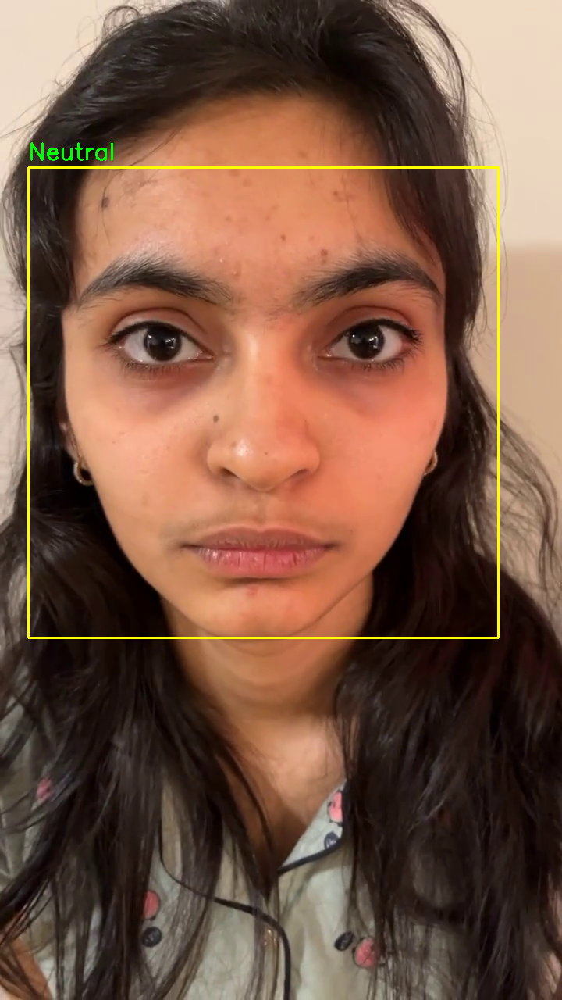

1/1 [==============================] - 0s 35ms/step


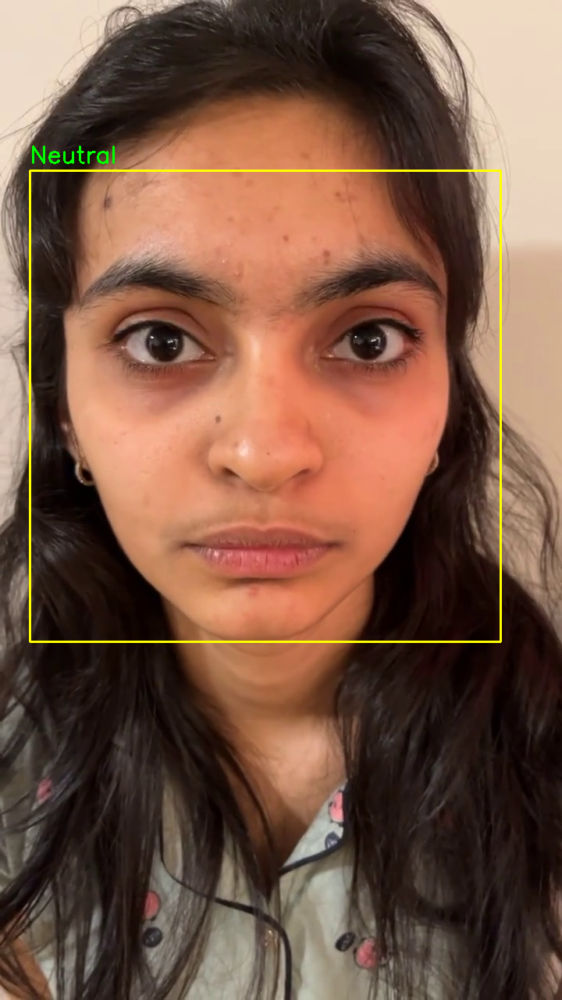

1/1 [==============================] - 0s 31ms/step


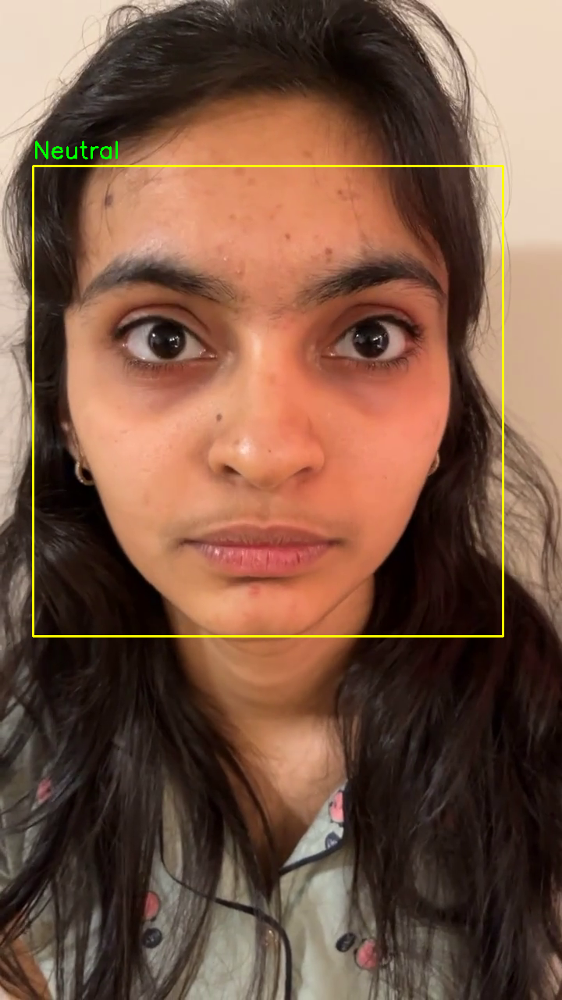

1/1 [==============================] - 0s 35ms/step


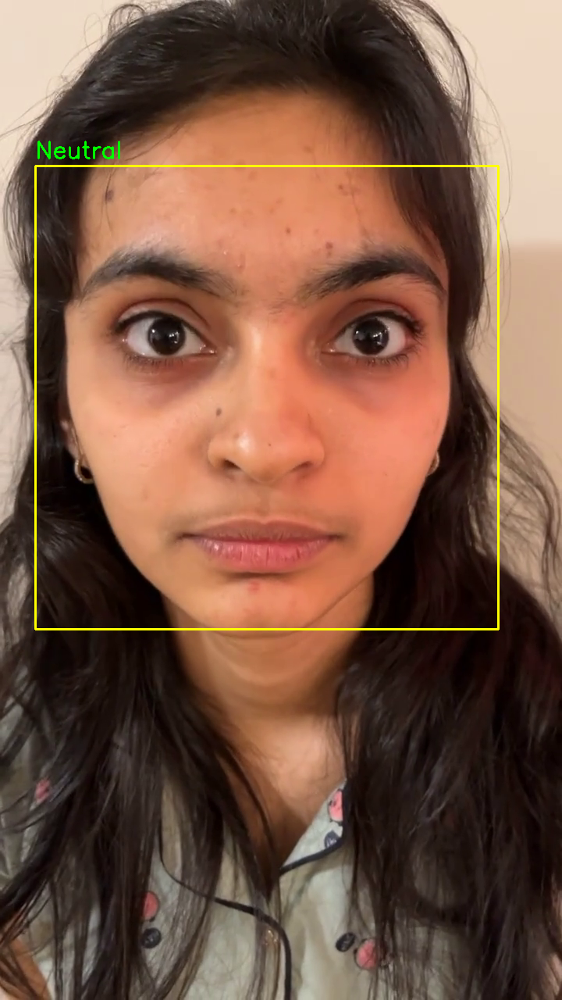

1/1 [==============================] - ETA: 0s

In [ ]:
import cv2
import numpy as np
from keras.models import load_model
from tensorflow.keras.preprocessing.image import img_to_array
from keras.models import load_model
from keras.preprocessing import image
from time import sleep
from google.colab.patches import cv2_imshow


face_classifier = cv2.CascadeClassifier('haarcascade_frontalface_default.xml')
classifier = load_model('model_1.h5')

emotion_labels = ['Angry','Disgust','Fear','Happy','Neutral', 'Sad', 'Surprise']

cap = cv2.VideoCapture('/content/test_file_1.mp4')

if not cap.isOpened():
    print("Error opening video stream or file")

while True:
    ret, frame = cap.read()
    
    if not ret:
        print("Error reading frame")
        break

    gray = cv2.cvtColor(frame,cv2.COLOR_BGR2GRAY)

    faces = face_classifier.detectMultiScale(gray)

    for (x,y,w,h) in faces:
        cv2.rectangle(frame,(x,y),(x+w,y+h),(0,255,255),2)
        roi_gray = gray[y:y+h,x:x+w]
        roi_gray = cv2.resize(roi_gray,(48,48),interpolation=cv2.INTER_AREA)

        if np.sum([roi_gray]) != 0:
            roi = roi_gray.astype('float')/255.0
            roi = img_to_array(roi)
            roi = np.expand_dims(roi,axis=0)

            prediction = classifier.predict(roi)[0]
            label = emotion_labels[prediction.argmax()]
            label_position = (x,y-10)
            cv2.putText(frame,label,label_position,cv2.FONT_HERSHEY_SIMPLEX,1,(0,255,0),2)
        else:
            cv2.putText(frame,'No Faces',(30,80),cv2.FONT_HERSHEY_SIMPLEX,1,(0,255,0),2)

    cv2_imshow(frame)
    
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

cap.release()
cv2.destroyAllWindows()


### Guess what! I got so many beautiful results from different time frames of the video.

Summary : For the model of Emotion Detection, I tried to increase the accuracy of the model by changing hyper-parameter like learning, batch size, number of epochs, number of dense laywers, pool size. but in the end, after doing Data Augmentation I was able to get accuracy around 70%. Lastly, I tried to detect Emotions from the video by using a Pre-trained model I have created with OpenCv library which showed better results. I like to extend this project from here in "ProjectII" which will be a great start for me.